# Regression

In [1]:
columns = [ 'stdohod', 'zdrav', 'tipotd', 'uslug', 'okpd2', 'okpdst', 'obroz', 
           'okved', 'okved2', 'vidtorgv', 'dol', 'tipushr', 'vozr', 'obras', 
           'zagr', 'vidfond', 'mosh', 'gilsem', 'spzakmp', 'vidzych', 'prich', 
           'vidpost', 'vidych', 'sptorg', 'spzakpr', 'sport', 'istkoop', 'skoop', 
           'okpdn', 'vidres', 'mest', 'okfs', 'vidazc', 'pokdor', 'selmash', 
           'okei', 'kategor', 'kultur', 'skot', 'post', 'vidtorg', 'ucheb', 
           'tipset', 'schil', 'mostep', 'kanal', 'istinv', 'grup_2', 'migr', 
           'nazsostv', 'wetwl', 'okogu', 'stash', 'okco']

In [2]:
dataset_columns = ['municipality', 'oktmo', 'year', 'indicator_value', 'indicator_unit']

In [3]:
# import pandas as pd
# from tqdm import tqdm

# # Путь к файлу и размер чанка
# file_path = '/root/blocksnet/tests/data/combined_filtered_data.csv'
# chunk_size = 100_000

# # Словарь для подсчета количества данных по годам
# data_per_year = {}

# # Чтение и обработка файла по чанкам
# for chunk in tqdm(pd.read_csv(file_path, encoding='utf-8', chunksize=chunk_size, low_memory=False)):
#     # Фильтрация по indicator_period
#     chunk_filtered = chunk[chunk['indicator_period'] == 'Значение показателя за год']

#     # Убедимся, что нужные колонки есть в чанке
#     available_columns = ['year'] + [col for col in columns if col in chunk_filtered.columns]
#     chunk_filtered = chunk_filtered[available_columns]

#     # Удалим строки без года
#     chunk_filtered = chunk_filtered.dropna(subset=['year'])

#     # Подсчет валидных значений (не NaN и не 0) по каждому году
#     for year, group in chunk_filtered.groupby('year'):
#         valid_count = 0
#         for col in columns:
#             if col in group.columns:
#                 valid_count += ((group[col].notna()) & (group[col] != 0)).sum()
#         data_per_year[year] = data_per_year.get(year, 0) + valid_count

# # Преобразуем словарь в Series для удобной сортировки и анализа
# data_per_year_series = pd.Series(data_per_year).sort_values(ascending=False)

# # Отображение отсортированных значений
# print("Количество данных по годам (от большего к меньшему):")
# print(data_per_year_series)

# # Находим год с наибольшим количеством данных
# if data_per_year_series.empty:
#     print("\nНет данных, удовлетворяющих условиям фильтрации.")
# else:
#     year_with_most_data = data_per_year_series.idxmax()
#     max_data_count = data_per_year_series.max()
#     print(f"\nГод с наибольшим количеством данных: {int(year_with_most_data)} ({max_data_count} значений)")

In [28]:
import pandas as pd
from tqdm import tqdm   

# Чтение файла по частям
chunk_size = 100_000  # Размер чанка (поправил на 100000, потому что было указано 100_000_0)
chunks = pd.read_csv('/root/blocksnet/tests/data/combined_filtered_data.csv', encoding='utf-8', chunksize=chunk_size, low_memory=False)

# Фильтрация чанков по году
filtered_chunks = []
for chunk in tqdm(chunks):
    # Фильтруем чанк по году 2010   
    chunk = chunk[chunk['year'] == 2022]
    filtered_chunk = chunk[chunk['indicator_period'] == 'Значение показателя за год']
    filtered_chunks.append(filtered_chunk)

# Объединяем все отфильтрованные чанки в один DataFrame
filtered_data = pd.concat(filtered_chunks, ignore_index=True)

filtered_data.to_csv('filtered_data.csv')

41it [00:28,  1.46it/s]


In [5]:
import pandas as pd

filtered_data = pd.read_csv('filtered_data.csv')

/tmp/ipykernel_171035/2034859486.py:3: DtypeWarning: Columns (22,24,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,48,52,53,54,55,56,57,58,59,60,61,65,66,67,68,69,70,71,73,74,75,76) have mixed types. Specify dtype option on import or set low_memory=False.
  filtered_data = pd.read_csv('filtered_data.csv')


In [5]:
filtered_data = filtered_data[dataset_columns + columns]

In [6]:
filtered_data

,municipality,oktmo,year,indicator_value,indicator_unit,stdohod,zdrav,tipotd,uslug,okpd2,...,mostep,kanal,istinv,grup_2,migr,nazsostv,wetwl,okogu,stash,okco
0,Бокситогорский муниципальный район,41603000,2006,916.0,Единица,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Бокситогорский муниципальный район,41603000,2007,706.0,Единица,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Бокситогорский муниципальный район,41603000,2008,805.0,Единица,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,Бокситогорское,41603101,2007,177.0,Единица,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Бокситогорское,41603101,2008,224.0,Единица,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3393778,Сосновоборский,41754000,2008,0.0,Рубль,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3393779,Сосновоборский,41754000,2008,11062.5,Рубль,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3393780,Сосновоборский,41754000,2008,21737.6,Рубль,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3393781,Сосновоборский,41754000,2008,15439.6,Рубль,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
filtered_data[dataset_columns + ['okpd2']].drop('oktmo', axis=1)

,municipality,year,indicator_value,indicator_unit,okpd2
0,Бокситогорский муниципальный район,2022,113.0,Единица,Число объектов бытового обслуживания населения...
1,Бокситогорский муниципальный район,2022,1.0,Единица,"Ремонт, окраска и пошив обуви"
2,Бокситогорский муниципальный район,2022,7.0,Единица,Ремонт и строительство жилья и других построек
3,Бокситогорский муниципальный район,2022,5.0,Единица,"Ремонт и пошив швейных, меховых и кожаных изде..."
4,Бокситогорский муниципальный район,2022,4.0,Единица,Услуги фотоателье
...,...,...,...,...,...
319058,Сосновоборский,2022,76400.0,Рубль,NaN
319059,Сосновоборский,2022,76400.0,Рубль,NaN
319060,Сосновоборский,2022,65944.4,Рубль,NaN
319061,Сосновоборский,2022,88642.3,Рубль,NaN


In [7]:
import pandas as pd

# Предполагаем, что columns содержит имена столбцов с подкатегориями
# Например, columns = ['subcategory1', 'subcategory2']
results = []
for col in columns:
    # Создаём pivot-таблицу для каждой колонки с подкатегориями
    pivot = pd.pivot_table(
        filtered_data,
        index=['municipality', 'oktmo', 'year'],  # Убрали indicator_unit из индекса
        columns=[col, 'indicator_unit'],          # Комбинируем подкатегории и indicator_unit
        values='indicator_value',
        aggfunc='sum',
        fill_value=0
    )
    # Переименовываем столбцы в формат {col}_{subcat}_{indicator_unit}
    pivot.columns = [f"{col}_{subcat}_{indicator_unit}" for subcat, indicator_unit in pivot.columns]
    results.append(pivot)

# Объединяем все pivot-таблицы
result = pd.concat(results, axis=1).reset_index()

# Заменяем filtered_data
filtered_data = result

# Удаляем исходные столбцы с подкатегориями и indicator_unit, если они остались
filtered_data = filtered_data.drop(columns=columns + ['indicator_unit'], errors='ignore')

In [9]:
filtered_data['stdohod_Доходы от использования имущества, находящегося в государственной и муниципальной собственности_Тысяча рублей']

0       1843.0
1        469.8
2       1992.0
3       1313.0
4       3142.0
         ...  
4368       NaN
4369       NaN
4370       NaN
4371       NaN
4372       NaN
Name: stdohod_Доходы от использования имущества, находящегося в государственной и муниципальной собственности_Тысяча рублей, Length: 4373, dtype: float64

In [10]:
import pandas as pd

# Открываем файл tep.pickle
tep = pd.read_pickle('/root/blocksnet/tests/data/tep.pickle').fillna(0)
indicators = pd.read_pickle('/root/blocksnet/tests/data/indicators.pickle').fillna(0)

In [11]:
import requests
import geopandas as gpd
import pandas as pd
import json
from shapely.geometry import shape

# Замените на нужные ID территорий
territories_ids = tep.index.values
url = f"http://10.32.1.107:5300/api/v1/territories/{','.join(map(str, territories_ids))}"

# Выполняем запрос
response = requests.get(url)
data = response.json()

# Парсим фичи
features = data["features"]

# Извлекаем нужные данные
records = []
for feature in features:
    props = feature["properties"]
    geometry = shape(feature["geometry"]) if feature["geometry"] else None

    record = {
        "territory_id": props["territory_id"],
        "okato_code": props.get("okato_code"),
        "oktmo_code": props.get("oktmo_code"),
        "name": props.get("name"),
        "geometry": geometry
    }
    records.append(record)

# Преобразуем в GeoDataFrame
territory_oktmo = gpd.GeoDataFrame(records, geometry="geometry")
territory_oktmo.set_index("territory_id", inplace=True)

# Оставляем только нужные столбцы
territory_oktmo = territory_oktmo[["okato_code", "oktmo_code", "name", "geometry"]]

In [12]:
territory_oktmo.oktmo_code = territory_oktmo.oktmo_code.astype(int)

In [13]:
territory_oktmo['territory_id'] = territory_oktmo.index.values

In [14]:
result = filtered_data.merge(territory_oktmo, left_on='oktmo', right_on='oktmo_code', how='inner')

In [15]:
result = result.set_index('territory_id')

In [20]:
import requests
import json
import pandas as pd

BASE_URL = "https://urban-api.idu.kanootoko.org"

def get_indicators_by_parent(parent_id):
    url = f"{BASE_URL}/api/v1/indicators_by_parent"
    params = {"parent_id": parent_id}
    try:
        response = requests.get(url, params=params)
        response.raise_for_status()
        return response.json()
    except requests.RequestException as e:
        print(f"Error fetching indicators: {e}")
        return None

def get_indicator_values(territory_id, indicator_ids=None):
    url = f"{BASE_URL}/api/v1/territory/{territory_id}/indicator_values"
    params = {}
    if indicator_ids:
        params["indicator_ids"] = ",".join(map(str, indicator_ids))
    try:
        response = requests.get(url, params=params)
        response.raise_for_status()
        return response.json()
    except requests.RequestException as e:
        print(f"Error fetching indicator values: {e}")
        return None

def create_indicator_dataframe(territory_ids, indicator_ids):
    data = []
    
    for territory_id in territory_ids:
        values = get_indicator_values(territory_id, indicator_ids)
        if values:
            for value in values:
                data.append({
                    'territory_id': value['territory']['id'],
                    'indicator_name': value['indicator']['name_full'],
                    'value': value['value']
                })
    
    # Create DataFrame
    df = pd.DataFrame(data)
    
    # Pivot to get territories as index and indicators as columns
    df_pivot = df.pivot(index='territory_id', columns='indicator_name', values='value')
    
    return df_pivot

In [21]:
# parent_id = 308
# territory_ids = tep.index.values

# # Get indicators
# indicators = get_indicators_by_parent(parent_id)
# indicator_ids = [indicator["indicator_id"] for indicator in indicators]


# df = create_indicator_dataframe(territory_ids, indicator_ids)
# df

In [22]:
# # Save to CSV (optional)
# df.to_csv('indicator_values.csv')

In [23]:
df = pd.read_csv('indicator_values.csv')
df = df.set_index('territory_id')

In [16]:
columns_to_drop = ['municipality','oktmo','year','geometry','geometry','oktmo_code','okato_code','name']
indicators = result.drop(columns_to_drop, axis=1)
indicators = indicators.fillna(0)

In [24]:
column_name = 'stdohod_Доходы от использования имущества, находящегося в государственной и муниципальной собственности_Тысяча рублей'

In [27]:
(indicators[column_name] > 0.0).mean()

np.float64(0.8132035290538485)

In [26]:
import pandas as pd
import numpy as np

# Преобразование в pandas DataFrame, если данные в виде numpy массивов
X = pd.DataFrame(tep) if not isinstance(tep, pd.DataFrame) else tep
Y = pd.DataFrame(indicators) if not isinstance(indicators, pd.DataFrame) else indicators

# Максимальное и минимальное значение для float64
float_max = np.finfo(np.float64).max
float_min = np.finfo(np.float64).min

# Проверка и замена NaN, inf и -inf в X
for col in X.columns:
    # Проверка, является ли колонка числовой
    if np.issubdtype(X[col].dtype, np.number):
        # Замена inf на float_max, -inf на float_min
        X[col] = X[col].replace(np.inf, float_max)
        X[col] = X[col].replace(-np.inf, float_min)
        # Замена NaN на 0
        X[col] = X[col].fillna(0)

# Проверка и замена NaN, inf и -inf в Y
for col in Y.columns:
    # Проверка, является ли колонка числовой
    if np.issubdtype(Y[col].dtype, np.number):
        # Замена inf на float_max, -inf на float_min
        Y[col] = Y[col].replace(np.inf, float_max)
        Y[col] = Y[col].replace(-np.inf, float_min)
        # Замена NaN на 0
        Y[col] = Y[col].fillna(0)

# Удаление полностью пустых колонок
X = X.dropna(axis=1, how='all')
Y = Y.dropna(axis=1, how='all')

In [27]:
# Вычисляем процент нулевых значений для каждого столбца
zero_percentage = ((Y == 0.0) | Y.isna()).mean()

# Оставляем только столбцы, где процент нулей <= 80%
Y = Y.loc[:, zero_percentage <= 0.2]

In [28]:
# Вычисляем процент нулевых значений для каждого столбца
zero_percentage = ((X == 0.0) | X.isna()).mean()

# Оставляем только столбцы, где процент нулей <= 80%
X = X.loc[:, zero_percentage <= 0.2]

In [29]:
X = X.replace([np.inf, -np.inf], np.nan).dropna()
Y = Y.replace([np.inf, -np.inf], np.nan).dropna()

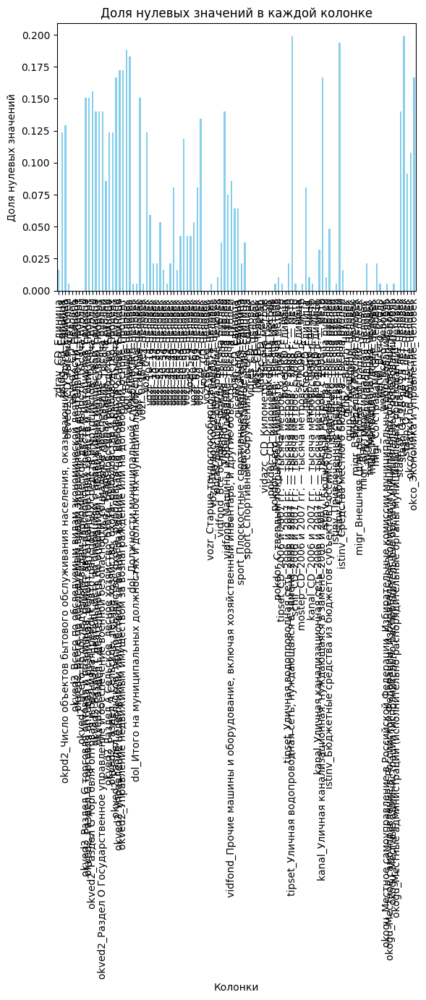

In [30]:
import pandas as pd
import matplotlib.pyplot as plt# Подсчёт количества нулевых значений в каждой колонке
zero_counts = (Y == 0).mean()

# Построение гистограммы
zero_counts.plot(kind='bar', color='skyblue')
plt.title("Доля нулевых значений в каждой колонке")
plt.xlabel("Колонки")
plt.ylabel("Доля нулевых значений")
plt.show()

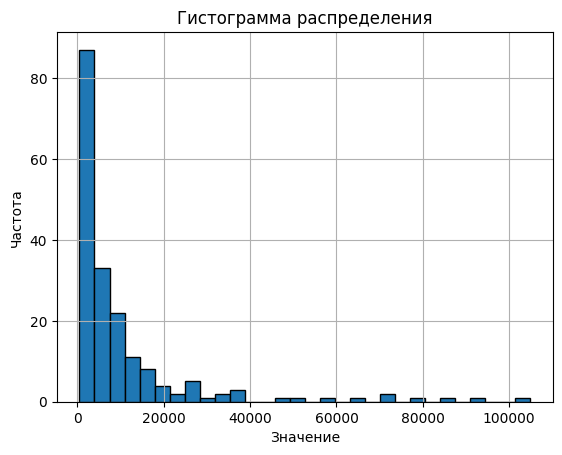

In [31]:
import matplotlib.pyplot as plt
import numpy as np

# Построение гистограммы
plt.hist(X['population'], bins=30, edgecolor='black')  # bins — количество столбцов
plt.title('Гистограмма распределения')
plt.xlabel('Значение')
plt.ylabel('Частота')
plt.grid(True)
plt.show()


In [32]:
# 1. Объединяем X и Y по столбцам
combined = pd.concat([X, Y], axis=1)

# 2. Фильтруем строки, где есть значения больше 8.988466e+305
filtered = combined[~combined.gt(8.988466e+304).any(axis=1)]

# 3. Разделяем обратно на X и Y
X = filtered[X.columns]
Y = filtered[Y.columns]

In [33]:
from sklearn.preprocessing import MinMaxScaler, StandardScaler

# Инициализация StandardScaler
scaler_X = MinMaxScaler()
scaler_Y = MinMaxScaler()

# Масштабирование X (tep)
X_columns = X.columns
X_index = X.index
X = scaler_X.fit_transform(X)
X = pd.DataFrame(X, columns=X_columns, index=X_index)

# Масштабирование Y (indicators)
Y_columns = Y.columns
Y_index = Y.index
Y = scaler_Y.fit_transform(Y)
Y = pd.DataFrame(Y, columns=Y_columns, index=Y_index)

In [36]:
Y

,zdrav_CD_Единица,uslug_CD_Единица,"okpd2_Число объектов бытового обслуживания населения, оказывающих услуги_Единица",okved2_CD_Тысяча рублей,okved2_CD_Человек,okved2_Всего по обследуемым видам экономической деятельности_Единица,okved2_Всего по обследуемым видам экономической деятельности_Процент,okved2_Всего по обследуемым видам экономической деятельности_Тысяча рублей,"okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Единица","okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Процент",...,wetwl_Всего_Человек,okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Рубль,okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Человек,okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Рубль,okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Человек,stash_От 1 года до 5 лет_Человек,stash_От 15 до 25 лет_Человек,stash_От 5 до 10 лет_Человек,okco_Науки об обществе_Человек,okco_Экономика и управление_Человек
3,0.022222,0.000000,0.000000,0.001059,0.017161,0.005267,0.0,0.000540,0.000000,0.0,...,0.024469,0.402343,0.024469,0.403515,0.025447,0.00,0.046512,0.014493,0.018182,0.035398
4,0.022222,0.000000,0.000000,0.001066,0.012508,0.002633,0.0,0.000540,0.003378,1.0,...,0.020436,0.367899,0.020436,0.368970,0.021253,0.04,0.011628,0.014493,0.027273,0.035398
5,0.022222,0.086860,0.088036,0.025899,0.202694,0.068466,0.0,0.059600,0.057432,1.0,...,0.112934,0.471298,0.112934,0.472670,0.117450,0.20,0.127907,0.014493,0.113636,0.203540
6,0.044444,0.000000,0.000000,0.001496,0.030037,0.003292,0.0,0.000257,0.003378,1.0,...,0.019629,0.438556,0.019629,0.439832,0.020414,0.02,0.011628,0.043478,0.000000,0.000000
7,0.022222,0.149220,0.151242,0.024364,0.159791,0.050033,0.0,0.013717,0.033784,1.0,...,0.264856,0.482669,0.264856,0.481345,0.266499,0.12,0.279070,0.130435,0.195455,0.141593
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
203,0.022222,0.011136,0.011287,0.001500,0.029659,0.013825,0.0,0.007437,0.003378,1.0,...,0.025813,0.399202,0.025813,0.400364,0.026846,0.06,0.023256,0.028986,0.000000,0.000000
204,0.044444,0.011136,0.011287,0.024082,0.041921,0.037525,0.0,0.058742,0.060811,1.0,...,0.035493,0.463854,0.035493,0.462714,0.033837,0.02,0.000000,0.115942,0.031818,0.061947
205,0.066667,0.000000,0.000000,0.000973,0.011925,0.030941,0.0,0.000847,0.006757,1.0,...,0.021511,0.321567,0.021511,0.297329,0.019575,0.00,0.034884,0.028986,0.009091,0.017699
206,0.044444,0.006682,0.006772,0.000751,0.015361,0.020408,1.0,0.000323,0.006757,1.0,...,0.016402,0.370281,0.016402,0.371359,0.017058,0.02,0.023256,0.014493,0.000000,0.000000


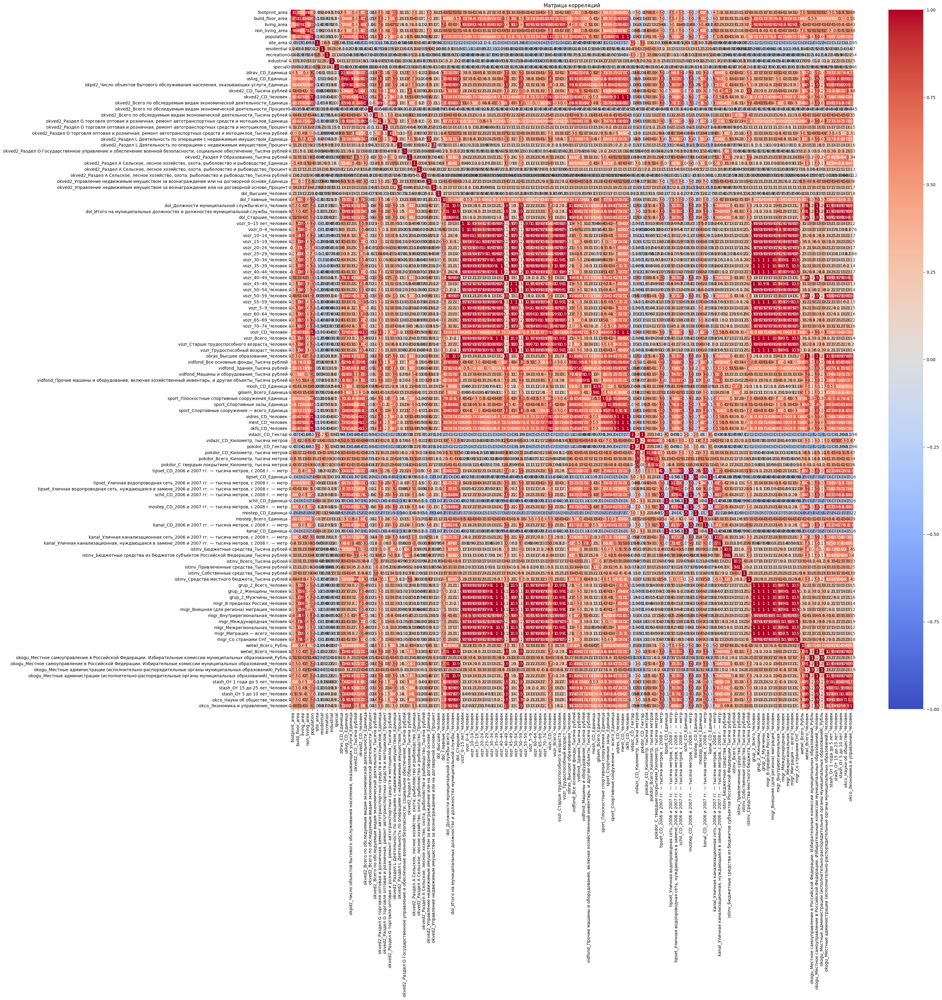

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

numpy_data  = pd.concat([X, Y], axis=1)
df = pd.DataFrame(numpy_data,)
correlation_matrix = df.corr()

plt.figure(figsize=(30, 30)) 
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', vmin=-1, vmax=1, center=0)
plt.title('Матрица корреляций')  
plt.show()

In [35]:
import optuna
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Функция для создания и оценки модели с заданными гиперпараметрами
def objective(trial):
    # Определяем пространство гиперпараметров для оптимизации
    # Используем дискретные значения для дробных параметров
    
    # Для n_estimators, используем дискретные значения
    n_estimators_options = [100, 150, 200, 300, 400, 500]
    n_estimators = trial.suggest_categorical('n_estimators', n_estimators_options)
    
    # Для learning_rate, используем список возможных значений
    learning_rate_options = [0.0001, 0.001, 0.01]
    learning_rate = trial.suggest_categorical('learning_rate', learning_rate_options)
    
    # Для max_depth, используем фиксированный список возможных значений
    max_depth_options = [5, 10, 15]
    max_depth = trial.suggest_categorical('max_depth', max_depth_options)
    
    # Для min_samples_split, используем небольшой список значений
    min_samples_split_options = [ 10, 15, 20]
    min_samples_split = trial.suggest_categorical('min_samples_split', min_samples_split_options)
    
    # Для min_samples_leaf, также используем дискретные значения
    min_samples_leaf_options = [4, 8, 16, 24, 32]
    min_samples_leaf = trial.suggest_categorical('min_samples_leaf', min_samples_leaf_options)
    
    # Для subsample, используем фиксированные значения
    subsample_options = [0.5,  0.7, 0.9, 1.0]
    subsample = trial.suggest_categorical('subsample', subsample_options)
    
    # Для max_features, также используем дискретные значения
    max_features_options = [0.5, 0.7, 0.9, 1.0, "sqrt", "log2"]
    max_features = trial.suggest_categorical('max_features', max_features_options)
    
    # Создаем модель с текущими параметрами
    params = {
        'n_estimators': n_estimators,
        'learning_rate': learning_rate,
        'max_depth': max_depth,
        'min_samples_split': min_samples_split,
        'min_samples_leaf': min_samples_leaf,
        'subsample': subsample,
        'max_features': max_features,
        'random_state': 42
    }
    
    gbr = GradientBoostingRegressor(**params)
    multi_gbr = MultiOutputRegressor(gbr)
    
    # Обучаем модель
    multi_gbr.fit(X_train, y_train)
    
    # Делаем предсказания
    y_pred = multi_gbr.predict(X_test)
    
    # Вычисляем среднюю MSE по всем выходным переменным
    mse = mean_squared_error(y_test, y_pred)
    
    return mse

# Предположим, что ваши данные уже загружены и предобработаны
# X - ваши масштабированные входные данные
# Y - ваши масштабированные выходные данные

# Разделение данных
X_train, X_test, y_train, y_test = train_test_split(
        X, Y, test_size=0.2, random_state=42
    )

# # Создаем исследование Optuna
# study = optuna.create_study(direction='minimize')  # Минимизируем MSE
# study.optimize(objective, n_trials=10)  # Количество итераций поиска

# # Выводим лучшие параметры
# print("Лучшие параметры:", study.best_params)
# print("Лучшее значение MSE:", study.best_value)

In [76]:
# Создаем финальную модель с лучшими параметрами
#study.best_params#
best_params = {'n_estimators': 150, 'learning_rate': 0.01, 'max_depth': 10, 'min_samples_split': 10, 'min_samples_leaf': 8, 'subsample': 0.9, 'max_features': 0.7}
best_gbr = GradientBoostingRegressor(random_state=42, **best_params,loss='huber')
best_multi_gbr = MultiOutputRegressor(best_gbr)
y_train = y_train.fillna(0)
# Обучаем финальную модель
best_multi_gbr.fit(X_train, y_train)

# Делаем предсказания
y_pred = best_multi_gbr.predict(X_test)

# Оценка (MSE для каждого выхода)
mse = mean_squared_error(y_test, y_pred, multioutput='raw_values')
print(f'Mean Squared Error для каждой целевой переменной: {mse.round(3)}')
print(f'Средняя MSE: {np.mean(mse)}')

Mean Squared Error для каждой целевой переменной: [0.029 0.023 0.023 0.027 0.015 0.031 0.    0.032 0.032 0.13  0.028 0.027
 0.166 0.    0.027 0.007 0.121 0.    0.028 0.155 0.025 0.005 0.04  0.04
 0.043 0.002 0.002 0.003 0.001 0.    0.    0.001 0.001 0.002 0.046 0.001
 0.001 0.04  0.001 0.004 0.001 0.002 0.002 0.015 0.001 0.001 0.001 0.042
 0.022 0.016 0.014 0.01  0.004 0.004 0.014 0.011 0.018 0.015 0.015 0.015
 0.011 0.018 0.011 0.016 0.022 0.013 0.016 0.054 0.012 0.017 0.014 0.054
 0.014 0.055 0.004 0.021 0.054 0.01  0.005 0.029 0.027 0.002 0.001 0.029
 0.027 0.001 0.001 0.001 0.001 0.001 0.004 0.004 0.001 0.001 0.004 0.027
 0.042 0.015 0.042 0.014 0.041 0.039 0.03  0.045 0.036 0.022]
Средняя MSE: 0.021604094504146572


In [78]:
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.multioutput import MultiOutputRegressor
from sklearn.utils import resample
from sklearn.metrics import mean_squared_error
from tqdm import tqdm  # импорт tqdm

def compute_bootstrap_intervals(X_train, y_train, X_test,
                                base_params, B=200,
                                alpha=0.05, random_state=42):
    """
    Возвращает:
      - mean_preds: (n_samples, n_outputs) точечные предсказания на оригинальной модели
      - ci_lower, ci_upper: границы CI для среднего прогноза
      - pi_lower, pi_upper: границы PI для новых наблюдений
    """
    rng = np.random.RandomState(random_state)
    base = GradientBoostingRegressor(random_state=random_state, loss='huber', **base_params)
    model_full = MultiOutputRegressor(base).fit(X_train, y_train)
    mean_preds = model_full.predict(X_test)

    boot_preds = np.zeros((B, X_test.shape[0], y_train.shape[1]))

    print(f"Выполняется бутстрэп ({B} повторов)...")
    for b in tqdm(range(B), desc="Bootstrapping"):
        Xb, yb = resample(X_train, y_train, random_state=rng.randint(0, 1e6))
        base_b = GradientBoostingRegressor(random_state=rng.randint(0, 1e6),
                                           loss='huber', **base_params)
        model_b = MultiOutputRegressor(base_b).fit(Xb, yb)
        boot_preds[b] = model_b.predict(X_test)
    
    lower_q, upper_q = 100 * (alpha/2), 100 * (1 - alpha/2)
    mean_boot = boot_preds.mean(axis=1)
    ci_lower = np.percentile(mean_boot, lower_q, axis=0)
    ci_upper = np.percentile(mean_boot, upper_q, axis=0)
    pi_lower = np.percentile(boot_preds, lower_q, axis=0)
    pi_upper = np.percentile(boot_preds, upper_q, axis=0)

    return mean_preds, ci_lower, ci_upper, pi_lower, pi_upper


# Применение
mean_pred, ci_lower, ci_upper, pi_lower, pi_upper = compute_bootstrap_intervals(
    X_train, y_train, X_test, best_params,
    B=10, alpha=0.05, random_state=42
)

# Оценим стандартный MSE
mse = mean_squared_error(y_test, mean_pred, multioutput='raw_values')
print(f"MSE каждой цели: {mse.round(3)}; Средняя MSE: {mse.mean():.3f}")

exaple_idx = 10
# Выведем доверительные интервалы для всех целей (выходов)
for i, name in enumerate(y_test.columns.values):
    print(f"\nДля {name}:")
    print(f"Среднее предсказание: {mean_pred[exaple_idx, i]:.3f}")
    print(f"95% CI для среднего: [{ci_lower[i]:.3f}, {ci_upper[i]:.3f}]")
    print(f"95% PI для нового наблюдения: [{pi_lower[exaple_idx, i]:.3f}, {pi_upper[exaple_idx, i]:.3f}]")


Выполняется бутстрэп (10 повторов)...


Bootstrapping: 100%|██████████| 10/10 [06:02<00:00, 36.24s/it]

MSE каждой цели: [0.029 0.023 0.023 0.027 0.015 0.031 0.    0.032 0.032 0.13  0.028 0.027
 0.166 0.    0.027 0.007 0.121 0.    0.028 0.155 0.025 0.005 0.04  0.04
 0.043 0.002 0.002 0.003 0.001 0.    0.    0.001 0.001 0.002 0.046 0.001
 0.001 0.04  0.001 0.004 0.001 0.002 0.002 0.015 0.001 0.001 0.001 0.042
 0.022 0.016 0.014 0.01  0.004 0.004 0.014 0.011 0.018 0.015 0.015 0.015
 0.011 0.018 0.011 0.016 0.022 0.013 0.016 0.054 0.012 0.017 0.014 0.054
 0.014 0.055 0.004 0.021 0.054 0.01  0.005 0.029 0.027 0.002 0.001 0.029
 0.027 0.001 0.001 0.001 0.001 0.001 0.004 0.004 0.001 0.001 0.004 0.027
 0.042 0.015 0.042 0.014 0.041 0.039 0.03  0.045 0.036 0.022]; Средняя MSE: 0.022

Для zdrav_CD_Единица:
Среднее предсказание: 0.066
95% CI для среднего: [0.050, 0.069]
95% PI для нового наблюдения: [0.051, 0.067]

Для uslug_CD_Единица:
Среднее предсказание: 0.017
95% CI для среднего: [0.032, 0.045]
95% PI для нового наблюдения: [0.011, 0.018]

Для okpd2_Число объектов бытового обслуживания населе

In [79]:
import numpy as np
import matplotlib.pyplot as plt

def plot_prediction_intervals(mean_preds, pi_lower, pi_upper, y_test, column_names, inverse_transform=False):
    """
    Строит графики для предсказательных интервалов (PI) для каждого выхода, используя имена колонок, 
    с отображением истинных значений из y_test.

    mean_preds — точечные предсказания, shape = (n_samples, n_outputs)
    pi_lower — нижняя граница PI, shape = (n_samples, n_outputs)
    pi_upper — верхняя граница PI, shape = (n_samples, n_outputs)
    y_test — истинные значения, shape = (n_samples, n_outputs)
    column_names — список с именами колонок (выходных переменных)
    inverse_transform — флаг для обратного преобразования
    """

    if inverse_transform:
        # Если требуется обратное преобразование, используем scaler_Y
        mean_preds = scaler_Y.inverse_transform(mean_preds)
        pi_lower = scaler_Y.inverse_transform(pi_lower)
        pi_upper = scaler_Y.inverse_transform(pi_upper)
        y_test = scaler_Y.inverse_transform(y_test)

    # Предположим, что для визуализации будем отображать только первые несколько тестовых точек
    n_samples = min(mean_preds.shape[0], 100)  # Выберем не более 10 точек для графиков
    
    plt.figure(figsize=(12, 6 * len(column_names)))  # Размер графика зависит от количества выходов
    
    for i, col_name in enumerate(column_names):
        plt.subplot(len(column_names), 1, i + 1)
        
        # Построение графика для i-го выхода
        plt.plot(np.arange(n_samples), mean_preds[:n_samples, i], label='Точечные предсказания', color='blue')
        plt.plot(np.arange(n_samples), y_test[:n_samples, i], label='Истинные значения', color='red', linestyle='--')
        plt.fill_between(np.arange(n_samples), pi_lower[:n_samples, i], pi_upper[:n_samples, i], 
                         color='lightblue', alpha=0.5, label='95% PI')
        
        plt.title(f'Предсказания и 95% PI для {col_name}')
        plt.xlabel('Номер образца')
        plt.ylabel(col_name)
        plt.legend()
    
    plt.tight_layout()
    plt.show()

column_names = y_train.columns.tolist()

# Вызов функции с передачей y_test
plot_prediction_intervals(mean_pred, pi_lower, pi_upper, y_test, column_names=y_train.columns.tolist(), inverse_transform=True)


Анализ для zdrav_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.375, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.385, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.275
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 64.263, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.093 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 15.861 (должно быть близко к 0 для нормального)


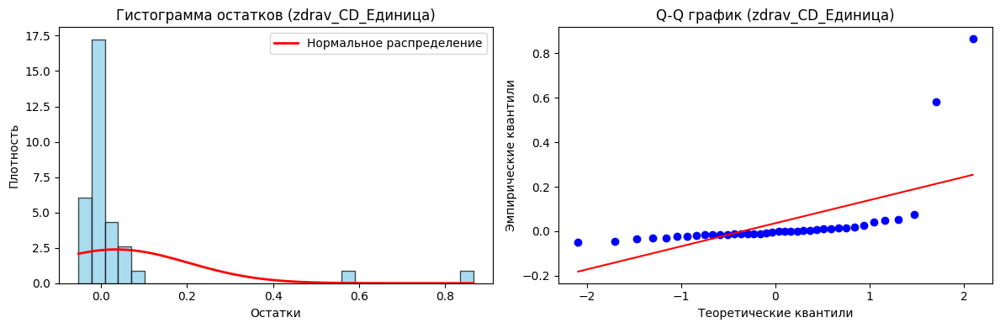


Анализ для uslug_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.342, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.447, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.524
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 64.871, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.130 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 16.212 (должно быть близко к 0 для нормального)


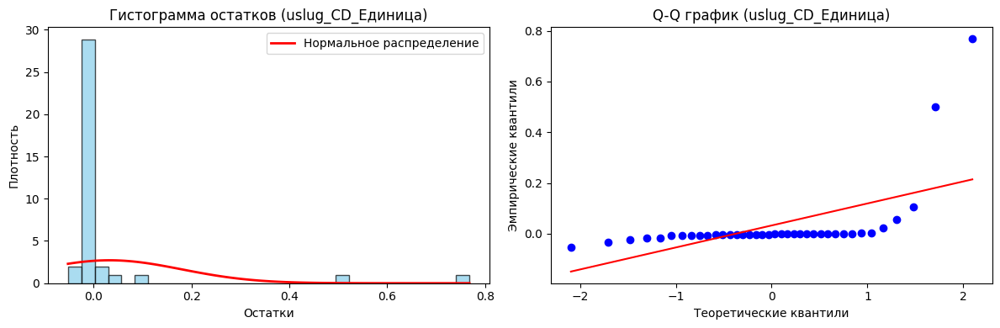


Анализ для okpd2_Число объектов бытового обслуживания населения, оказывающих услуги_Единица:
Тест Шапиро-Уилка: статистика = 0.339, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.468, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.560
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 66.258, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.213 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 

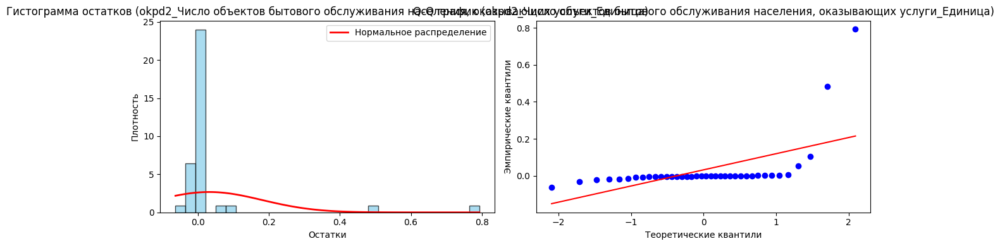


Анализ для okved2_CD_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.325, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.390, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.895
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 76.030, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.866 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 23.915 (должно быть близко к 0 для нормального)


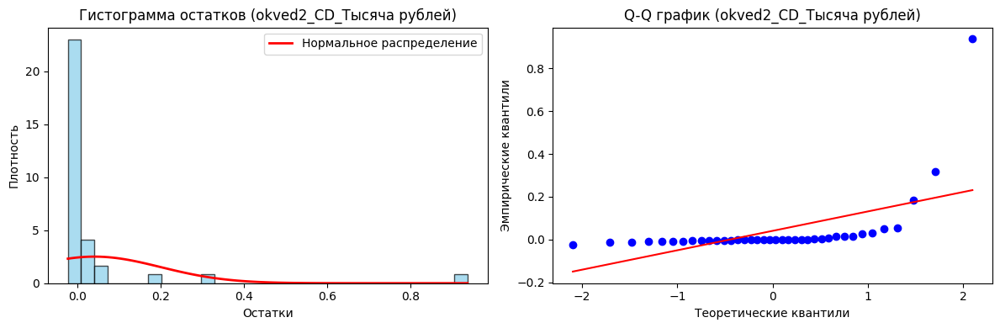


Анализ для okved2_CD_Человек:
Тест Шапиро-Уилка: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.819
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.137, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.825 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.831 (должно быть близко к 0 для нормального)


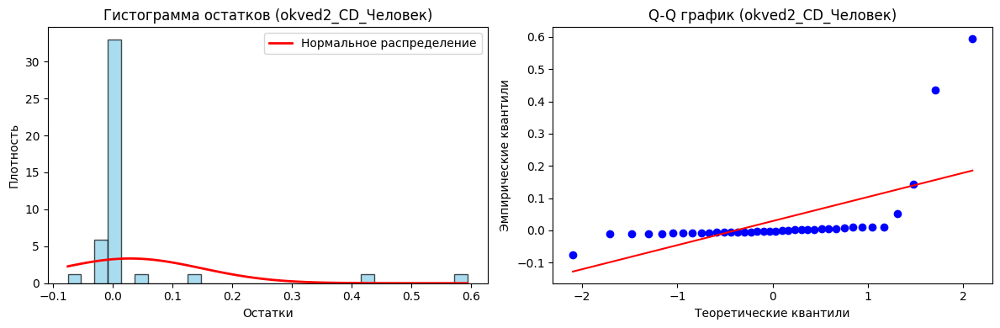


Анализ для okved2_Всего по обследуемым видам экономической деятельности_Единица:
Тест Шапиро-Уилка: статистика = 0.331, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.406, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.712
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.282, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.880 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.427 (долж

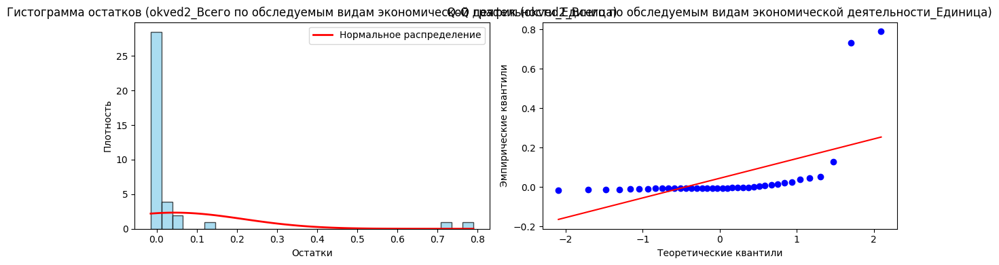


Анализ для okved2_Всего по обследуемым видам экономической деятельности_Процент:
Тест Шапиро-Уилка: статистика = 1.000, p-значение = 1.000
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Колмогорова-Смирнова: статистика = nan, p-значение = nan
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = nan
  => Нет оснований отвергать нормальность (статистика <= 0.529 при уровне значимости 15.0%)
  => Нет оснований отвергать нормальность (статистика <= 0.603 при уровне значимости 10.0%)
  => Нет оснований отвергать нормальность (статистика <= 0.723 при уровне значимости 5.0%)
  => Нет оснований отвергать нормальность (статистика <= 0.844 при уровне значимости 2.5%)
  => Нет оснований отвергать нормальность (статистика <= 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = nan, p-значение = nan
  => Нет оснований отвергать нормальность (p >= 0.05)
Асимметрия (Skewness): nan (должно быть близко к 0 для нормального)
Эксцесс (Kurto

/root/blocksnet/.venv/lib/python3.12/site-packages/scipy/stats/_axis_nan_policy.py:586: UserWarning: scipy.stats.shapiro: Input data has range zero. The results may not be accurate.
  res = hypotest_fun_out(*samples, **kwds)
/root/blocksnet/.venv/lib/python3.12/site-packages/scipy/stats/_distn_infrastructure.py:2129: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)
/root/blocksnet/.venv/lib/python3.12/site-packages/scipy/stats/_morestats.py:2215: RuntimeWarning: invalid value encountered in divide
  w = (y - xbar) / s
/root/blocksnet/.venv/lib/python3.12/site-packages/scipy/stats/_distn_infrastructure.py:2046: RuntimeWarning: invalid value encountered in divide
  x = np.asarray((x - loc)/scale, dtype=dtyp)


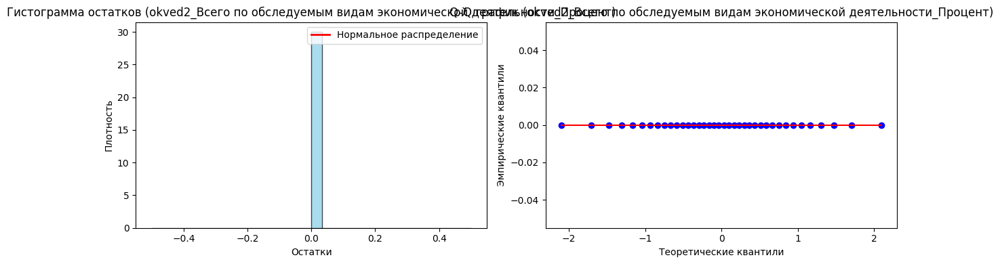


Анализ для okved2_Всего по обследуемым видам экономической деятельности_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.448, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.407, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.107
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 47.791, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.107 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.782 (

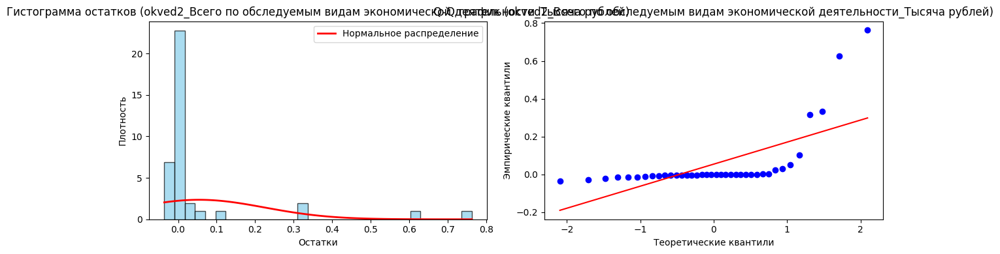


Анализ для okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Единица:
Тест Шапиро-Уилка: статистика = 0.355, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.415, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.425
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 57.469, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.697 (должно быть близко к 0 для нормального)
Эк

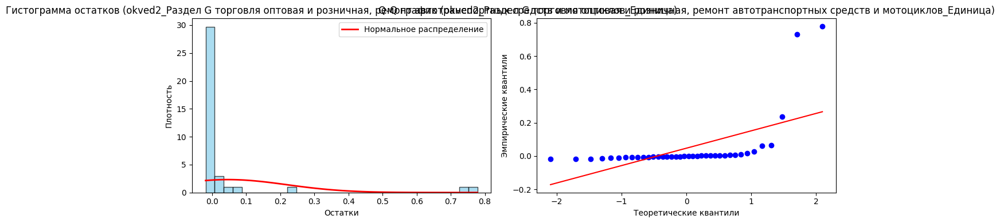


Анализ для okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Процент:
Тест Шапиро-Уилка: статистика = 0.812, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.344, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 3.647
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 9.175, p-значение = 0.010
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): -0.890 (должно быть близко к 0 для нормального)
Экс

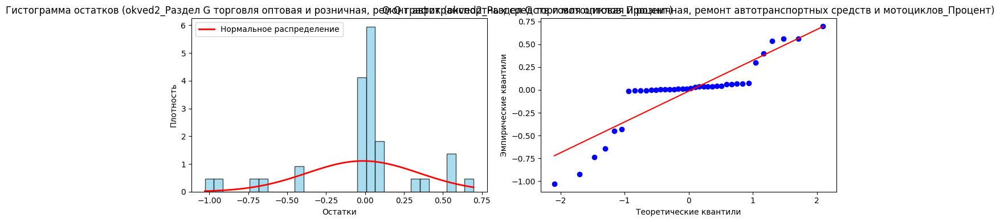


Анализ для okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.312, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.458, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 11.154
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 70.286, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.445 (должно быть близко к 0 для нормально

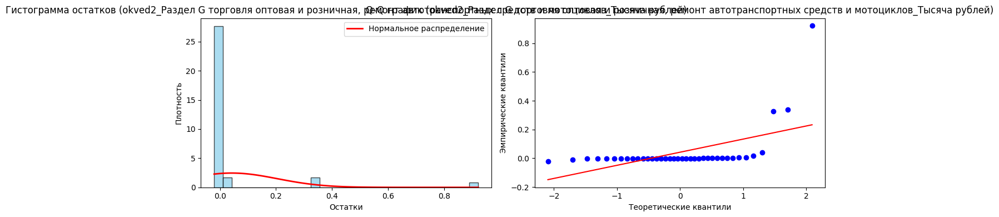


Анализ для okved2_Раздел L Деятельность по операциям с недвижимым имуществом_Единица:
Тест Шапиро-Уилка: статистика = 0.493, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.372, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.318
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 52.525, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.356 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 10.657 (

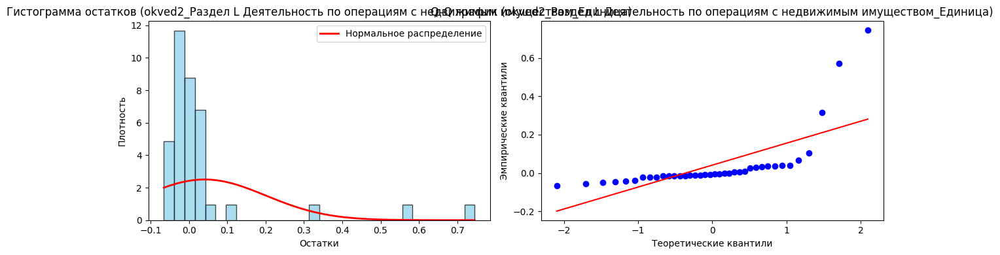


Анализ для okved2_Раздел L Деятельность по операциям с недвижимым имуществом_Процент:
Тест Шапиро-Уилка: статистика = 0.835, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.331, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 3.238
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 4.891, p-значение = 0.087
  => Нет оснований отвергать нормальность (p >= 0.05)
Асимметрия (Skewness): -0.672 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 0.64

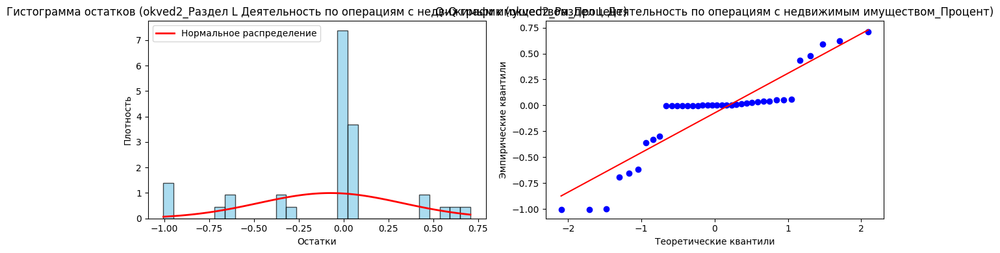


Анализ для okved2_Раздел O Государственное управление и обеспечение военной безопасности, социальное обеспечение_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.437, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.393, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.665
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 56.791, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.594 (должно быть близко к 0 для

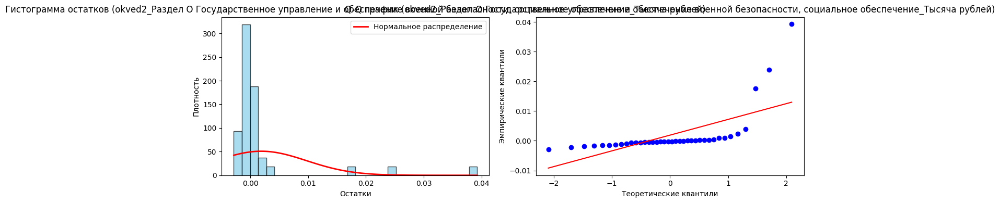


Анализ для okved2_Раздел P Образование_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.283, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.441, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.808
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 79.578, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 5.147 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 26.487 (должно быть близко к 0 для норм

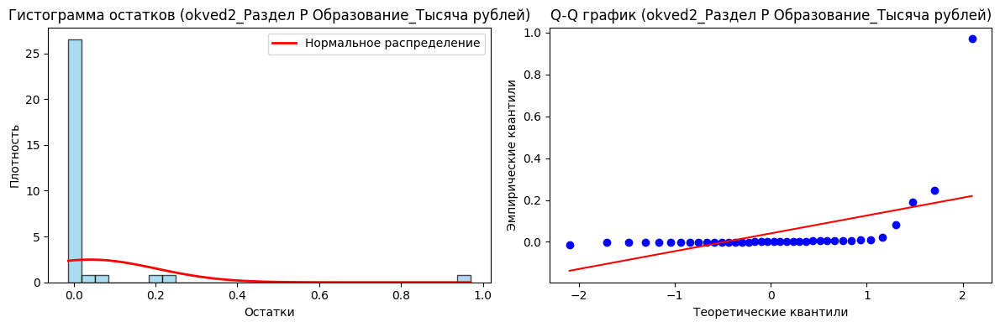


Анализ для okved2_Раздел А Сельское, лесное хозяйство, охота, рыболовство и рыбоводство_Единица:
Тест Шапиро-Уилка: статистика = 0.706, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.218, p-значение = 0.046
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.307
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 52.611, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.074 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis

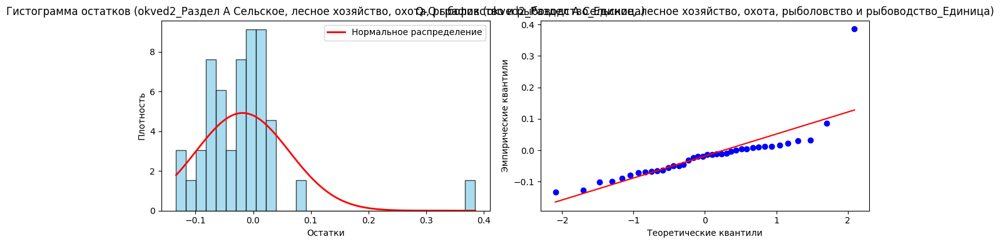


Анализ для okved2_Раздел А Сельское, лесное хозяйство, охота, рыболовство и рыбоводство_Процент:
Тест Шапиро-Уилка: статистика = 0.677, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.399, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.550
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 21.381, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): -1.789 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosi

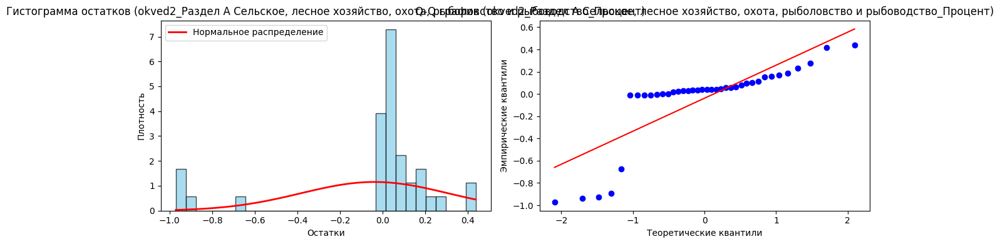


Анализ для okved2_Раздел А Сельское, лесное хозяйство, охота, рыболовство и рыбоводство_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.754, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.197, p-значение = 0.092
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 1.990
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 46.568, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.741 (должно быть близко к 0 для нормального)
Эксцесс

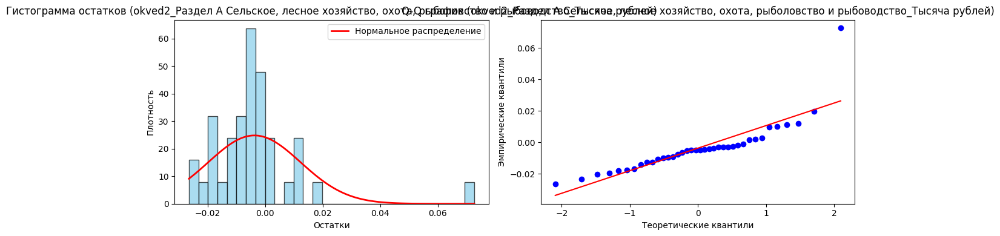


Анализ для okved2_Управление недвижимым имуществом за вознаграждение или на договорной основе_Единица:
Тест Шапиро-Уилка: статистика = 0.585, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.308, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.065
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 40.300, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.710 (должно быть близко к 0 для нормального)
Эксцесс (Ku

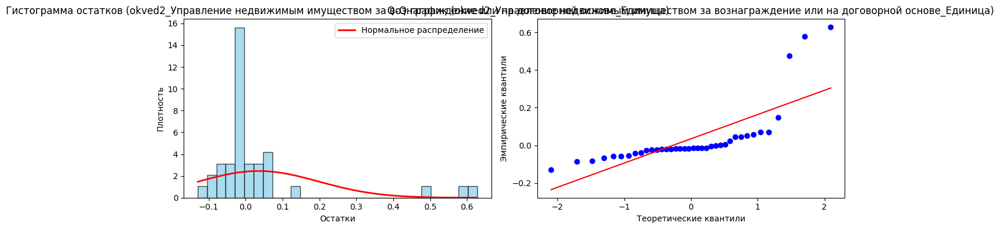


Анализ для okved2_Управление недвижимым имуществом за вознаграждение или на договорной основе_Процент:
Тест Шапиро-Уилка: статистика = 0.851, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.324, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.995
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 3.173, p-значение = 0.205
  => Нет оснований отвергать нормальность (p >= 0.05)
Асимметрия (Skewness): -0.552 (должно быть близко к 0 для нормального)
Эксцесс

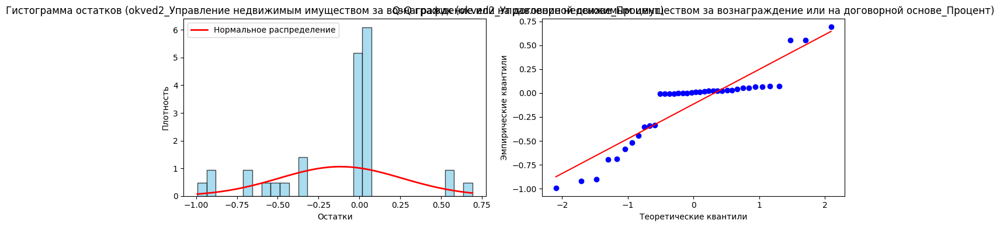


Анализ для dol_Высшие_Человек:
Тест Шапиро-Уилка: статистика = 0.854, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.262, p-значение = 0.009
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.720
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 2.778, p-значение = 0.249
  => Нет оснований отвергать нормальность (p >= 0.05)
Асимметрия (Skewness): -0.561 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 0.108 (должно быть близко к 0 для нормального)


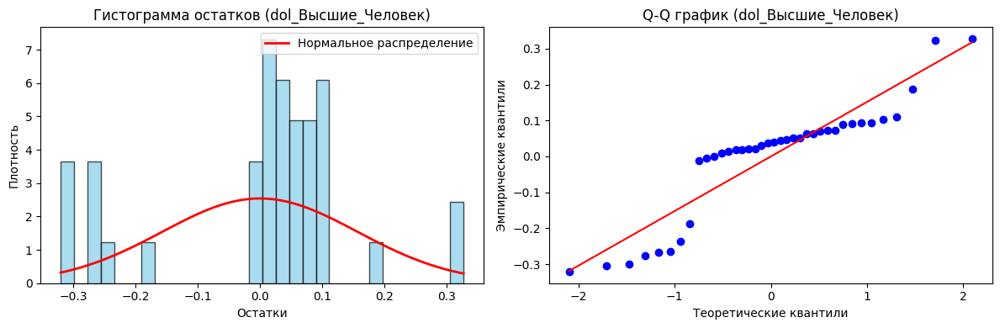


Анализ для dol_Главные_Человек:
Тест Шапиро-Уилка: статистика = 0.698, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.309, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.406
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 34.771, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.335 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.569 (должно быть близко к 0 для нормального)


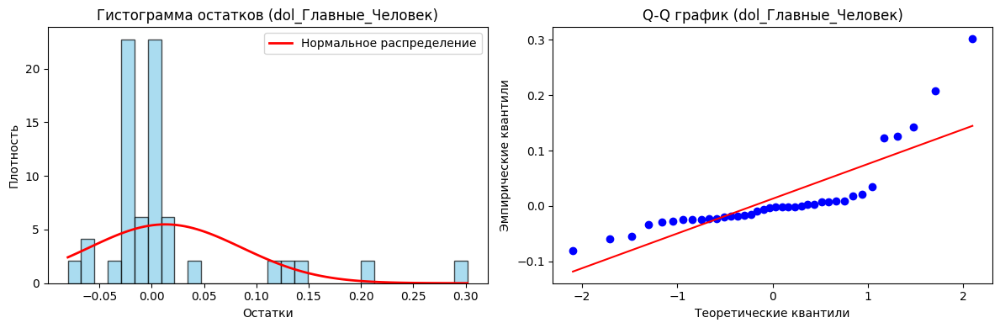


Анализ для dol_Должности муниципальной службы-всего_Человек:
Тест Шапиро-Уилка: статистика = 0.438, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.510
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.740, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.164 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.076 (должно быть близко к 0 для

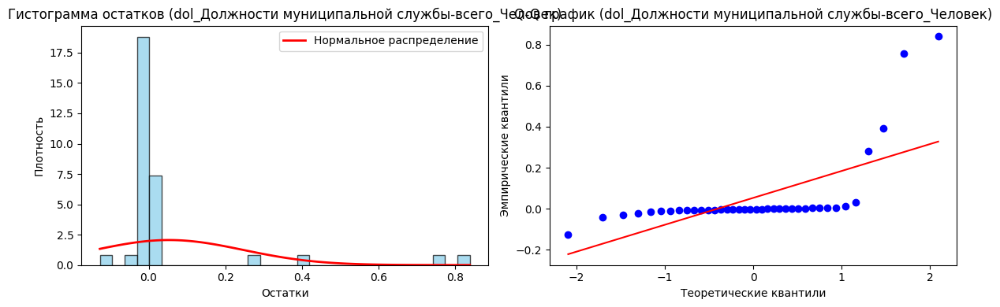


Анализ для dol_Итого на муниципальных должностях и должностях муниципальной службы_Человек:
Тест Шапиро-Уилка: статистика = 0.433, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.455, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.611
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 49.126, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.186 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.

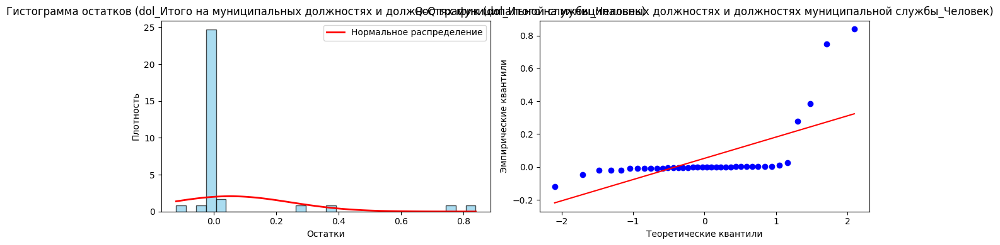


Анализ для dol_Старшие_Человек:
Тест Шапиро-Уилка: статистика = 0.423, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.465, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.562
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.150, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.249 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.524 (должно быть близко к 0 для нормального)


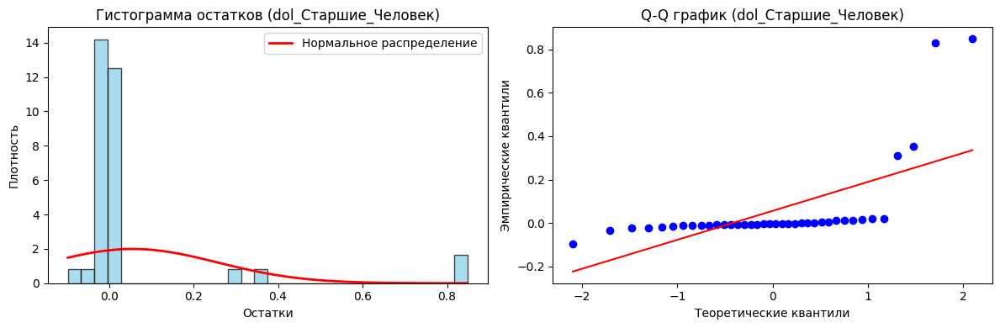


Анализ для vozr_0‒15 лет_Человек:
Тест Шапиро-Уилка: статистика = 0.469, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.389, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.642
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 44.686, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.964 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.574 (должно быть близко к 0 для нормального)


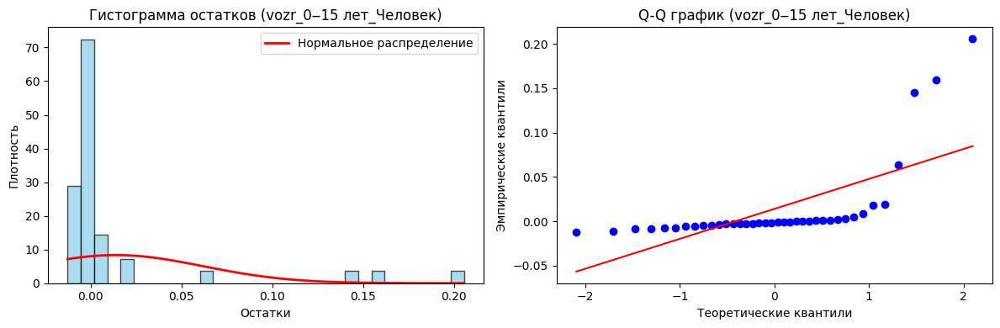


Анализ для vozr_0‒4_Человек:
Тест Шапиро-Уилка: статистика = 0.460, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.415, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.911
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 42.947, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.892 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.912 (должно быть близко к 0 для нормального)


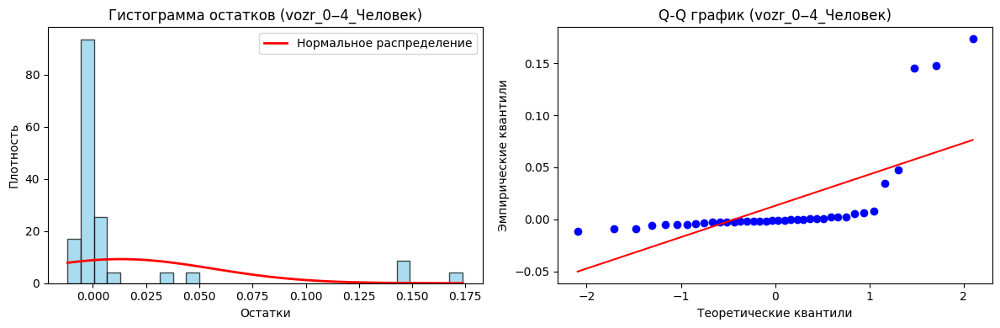


Анализ для vozr_10‒14_Человек:
Тест Шапиро-Уилка: статистика = 0.489, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.394, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.087
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 46.999, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.037 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.714 (должно быть близко к 0 для нормального)


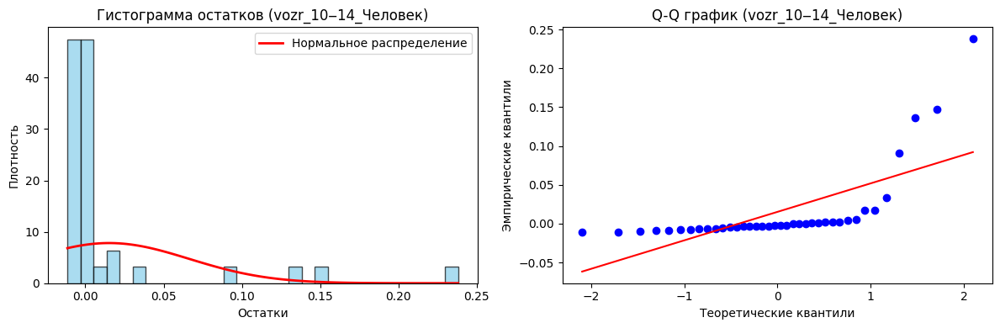


Анализ для vozr_15‒19_Человек:
Тест Шапиро-Уилка: статистика = 0.645, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.365, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.140
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 23.055, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.923 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.292 (должно быть близко к 0 для нормального)


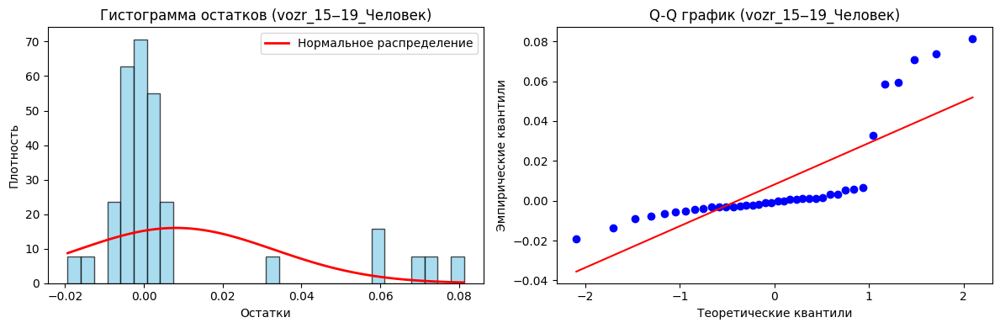


Анализ для vozr_20‒24_Человек:
Тест Шапиро-Уилка: статистика = 0.606, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.329, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.468
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 47.338, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.981 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.431 (должно быть близко к 0 для нормального)


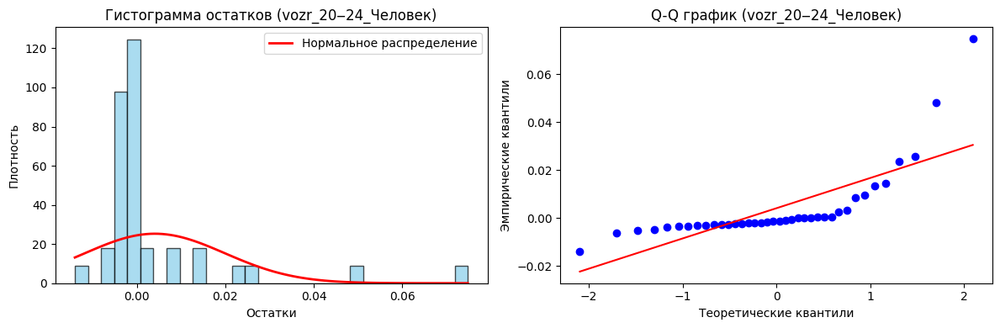


Анализ для vozr_25‒29_Человек:
Тест Шапиро-Уилка: статистика = 0.474, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.362, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.033
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 51.918, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.308 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 10.537 (должно быть близко к 0 для нормального)


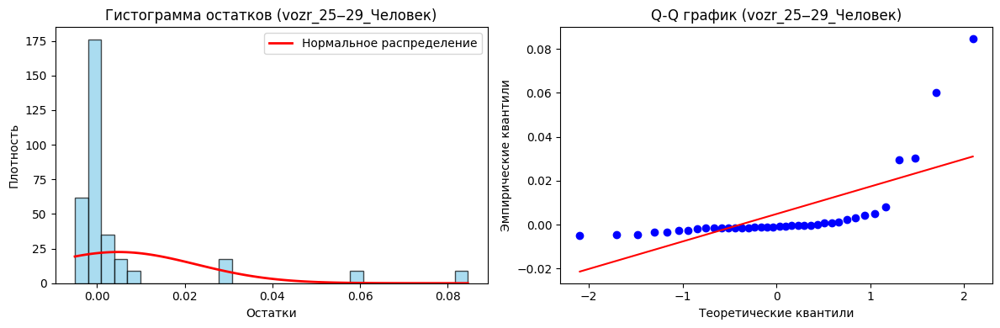


Анализ для vozr_30‒34_Человек:
Тест Шапиро-Уилка: статистика = 0.486, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.391, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.115
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 46.697, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.042 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.450 (должно быть близко к 0 для нормального)


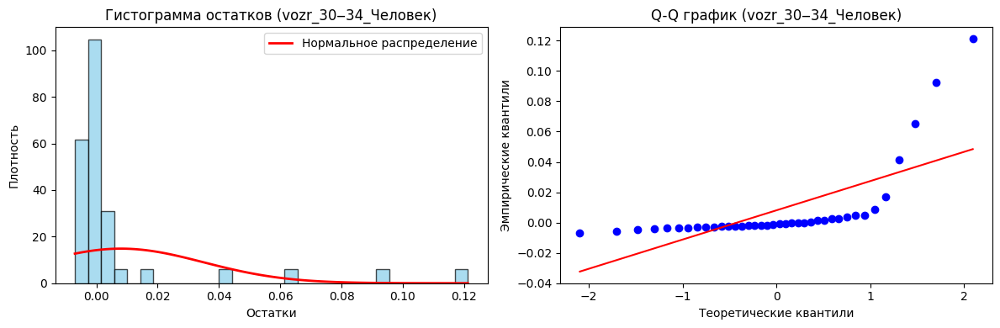


Анализ для vozr_35‒39_Человек:
Тест Шапиро-Уилка: статистика = 0.473, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.401, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.547
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 43.026, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.885 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.012 (должно быть близко к 0 для нормального)


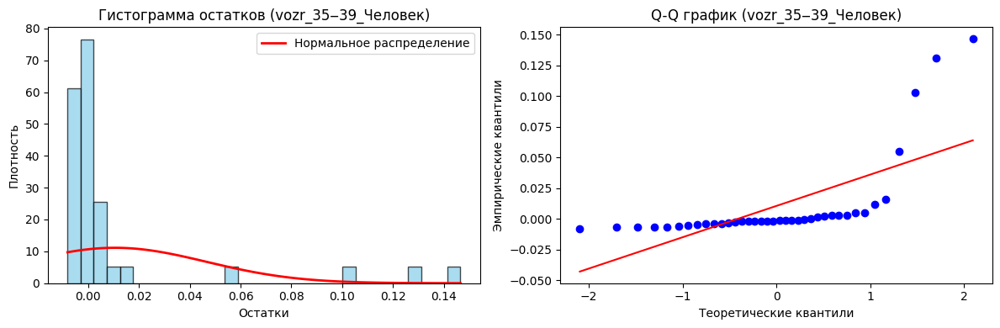


Анализ для vozr_40‒44_Человек:
Тест Шапиро-Уилка: статистика = 0.483, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.400, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.715
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 39.044, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.697 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.779 (должно быть близко к 0 для нормального)


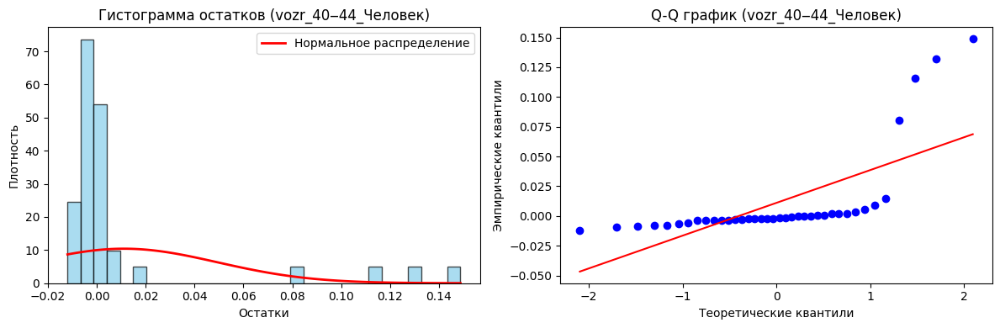


Анализ для vozr_40‒49_Человек:
Тест Шапиро-Уилка: статистика = 0.462, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.455, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.866
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 47.165, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.079 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.520 (должно быть близко к 0 для нормального)


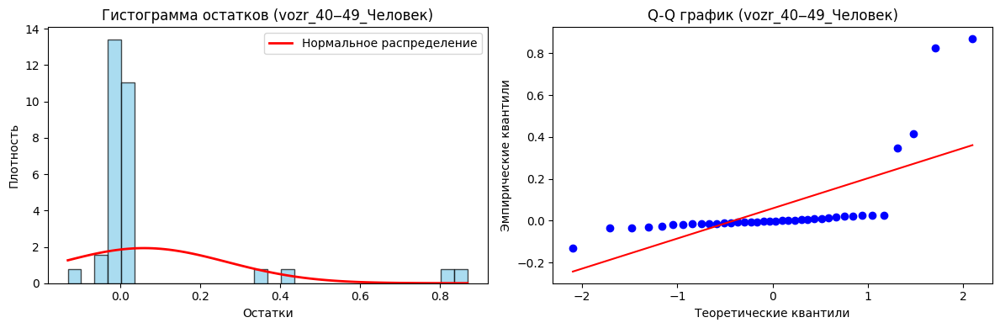


Анализ для vozr_45‒49_Человек:
Тест Шапиро-Уилка: статистика = 0.593, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.337, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.432
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 36.033, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.496 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.299 (должно быть близко к 0 для нормального)


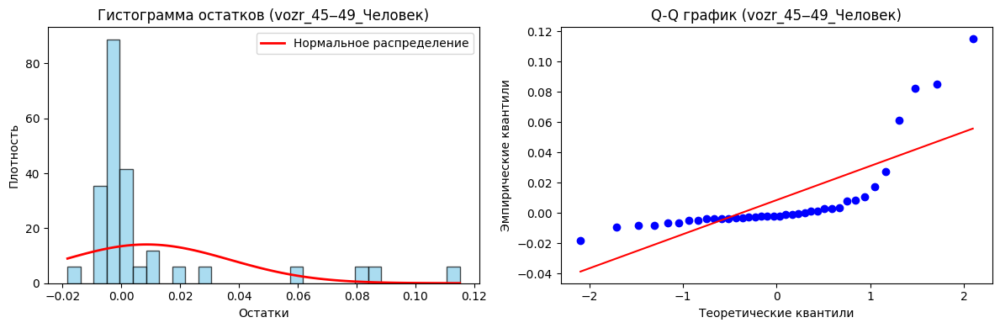


Анализ для vozr_50‒54_Человек:
Тест Шапиро-Уилка: статистика = 0.565, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.337, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.886
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 37.468, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.578 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.601 (должно быть близко к 0 для нормального)


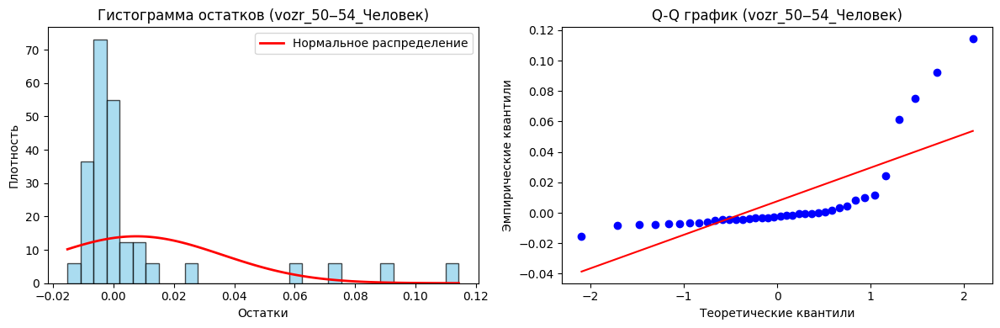


Анализ для vozr_50‒59_Человек:
Тест Шапиро-Уилка: статистика = 0.459, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.414, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.736
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 47.366, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.095 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.547 (должно быть близко к 0 для нормального)


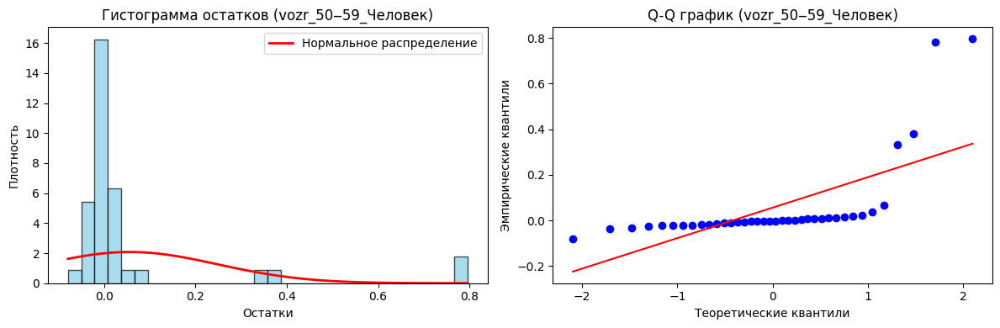


Анализ для vozr_55‒59_Человек:
Тест Шапиро-Уилка: статистика = 0.545, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.368, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.300
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 37.806, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.609 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.608 (должно быть близко к 0 для нормального)


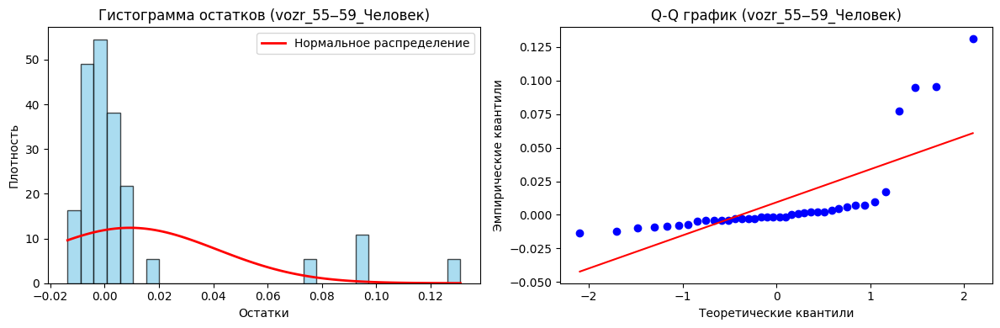


Анализ для vozr_5‒9_Человек:
Тест Шапиро-Уилка: статистика = 0.441, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.438, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.198
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 45.440, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.019 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.708 (должно быть близко к 0 для нормального)


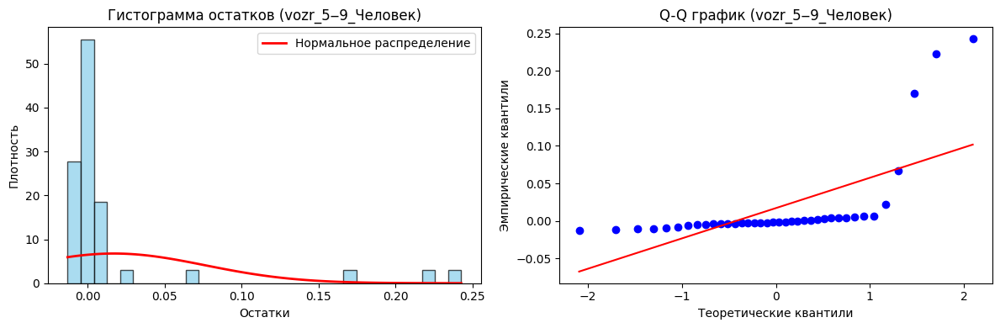


Анализ для vozr_60‒64_Человек:
Тест Шапиро-Уилка: статистика = 0.652, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.323, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.057
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 39.767, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.587 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.931 (должно быть близко к 0 для нормального)


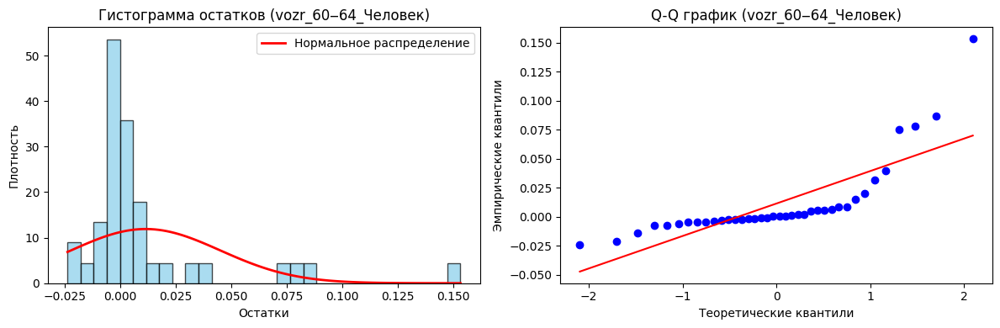


Анализ для vozr_65‒69_Человек:
Тест Шапиро-Уилка: статистика = 0.723, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.261, p-значение = 0.009
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 3.836
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 27.780, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.051 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 3.651 (должно быть близко к 0 для нормального)


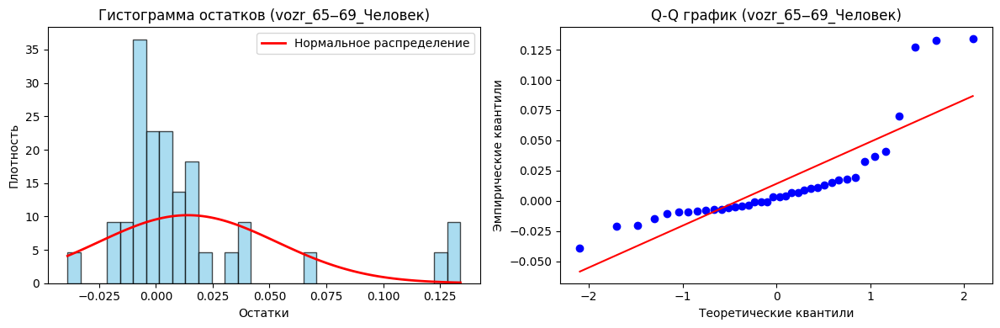


Анализ для vozr_70‒74_Человек:
Тест Шапиро-Уилка: статистика = 0.669, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.248, p-значение = 0.015
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.083
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 41.725, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.691 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.501 (должно быть близко к 0 для нормального)


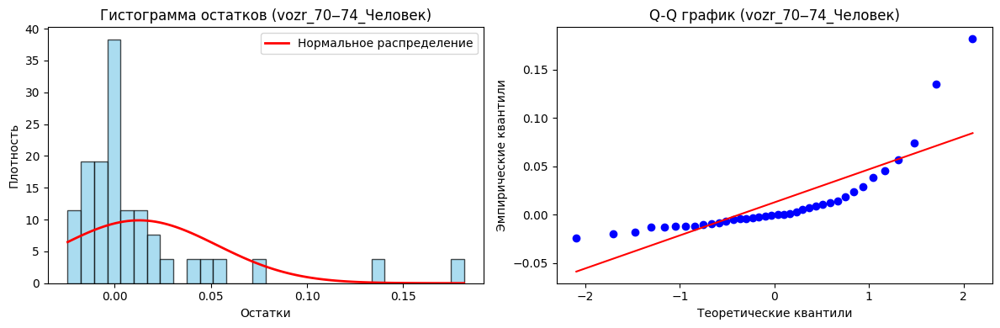


Анализ для vozr_CD_Человек:
Тест Шапиро-Уилка: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.819
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.137, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.825 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.831 (должно быть близко к 0 для нормального)


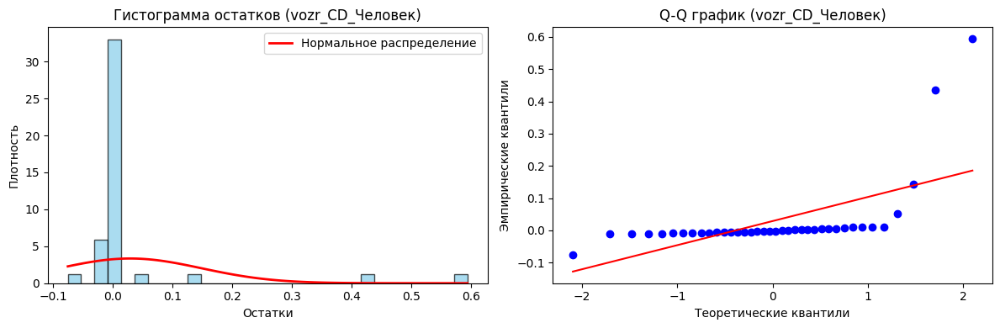


Анализ для vozr_Всего_Человек:
Тест Шапиро-Уилка: статистика = 0.509, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.382, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.966
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 40.591, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.753 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.343 (должно быть близко к 0 для нормального)


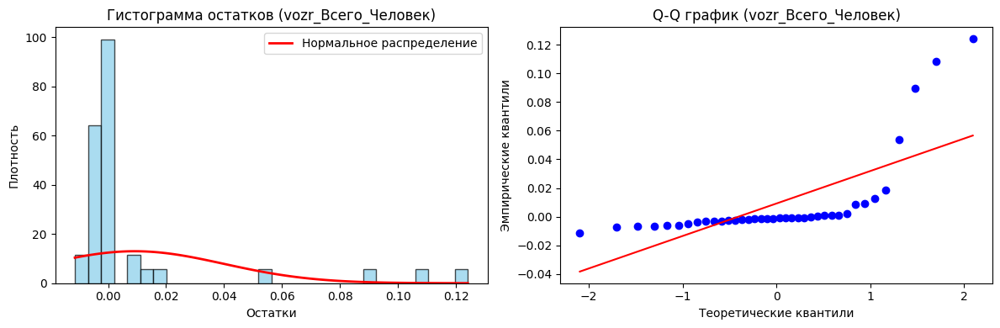


Анализ для vozr_Старше трудоспособного возраста_Человек:
Тест Шапиро-Уилка: статистика = 0.663, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.282, p-значение = 0.004
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.050
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 33.885, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.352 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 4.987 (должно быть близко к 0 для нор

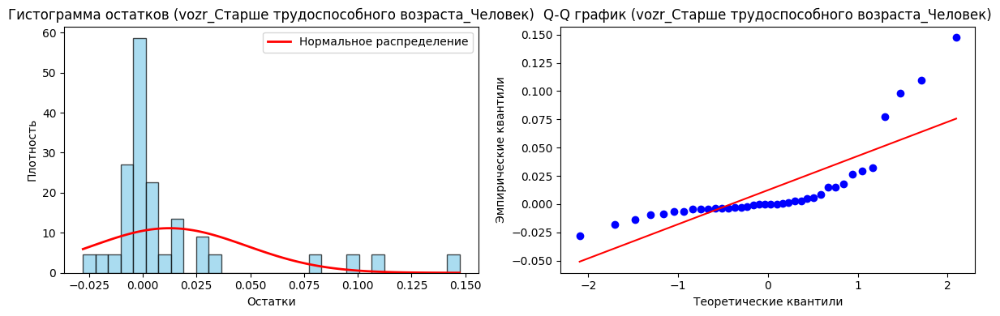


Анализ для vozr_Трудоспособный возраст_Человек:
Тест Шапиро-Уилка: статистика = 0.517, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.352, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.661
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 42.056, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.816 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.845 (должно быть близко к 0 для нормального)

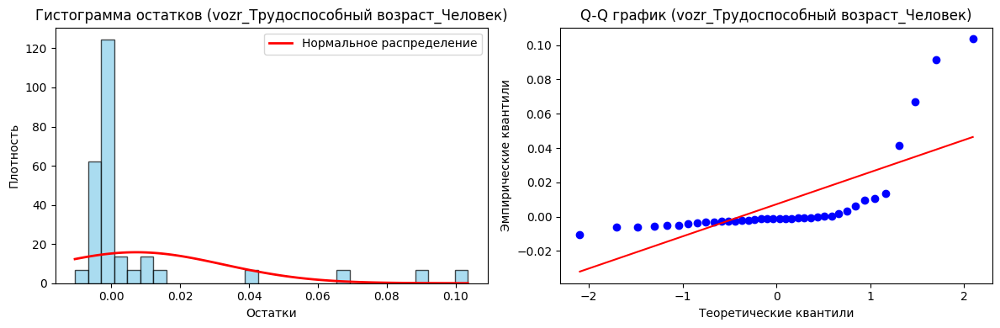


Анализ для obras_Высшее образование_Человек:
Тест Шапиро-Уилка: статистика = 0.441, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.463, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.465
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.123, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.132 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.844 (должно быть близко к 0 для нормального)


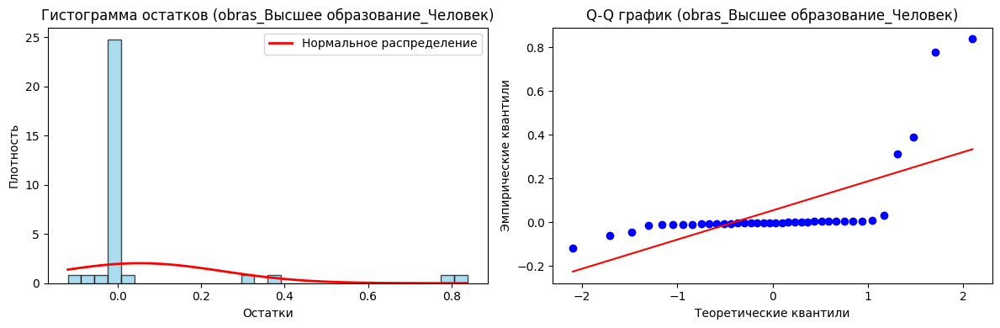


Анализ для vidfond_Все основные фонды_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.425, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.415, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.806
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 55.707, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.574 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 11.665 (должно быть близко к 0 для нормал

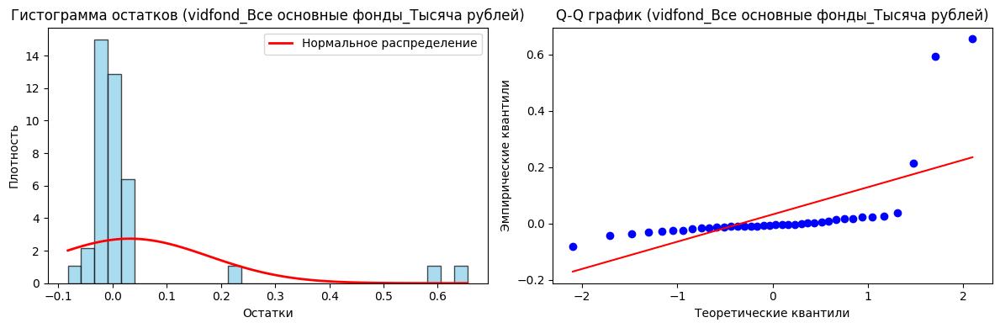


Анализ для vidfond_Здания_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.528, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.302, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.095
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 57.050, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.565 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.130 (должно быть близко к 0 для нормального)


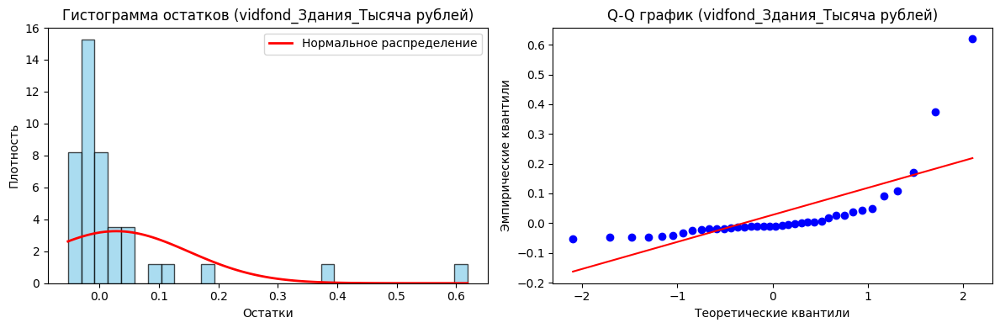


Анализ для vidfond_Машины и оборудование_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.272, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.440, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.503
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 83.840, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 5.510 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 29.685 (должно быть близко к 0 для но

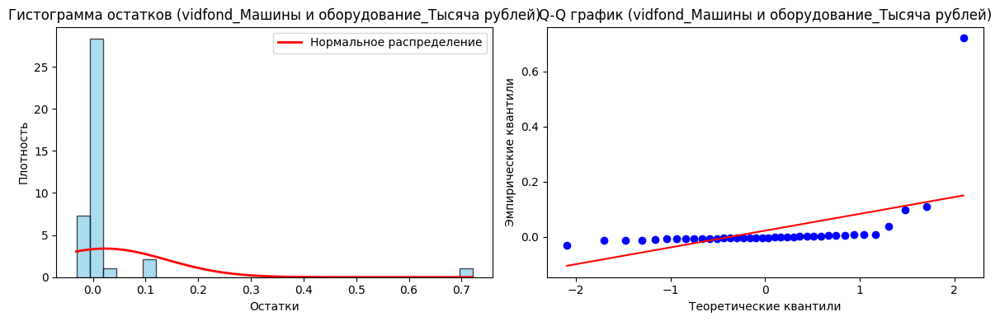


Анализ для vidfond_Прочие машины и оборудование, включая хозяйственный инвентарь, и другие объекты_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.258, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.436, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 10.789
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 84.611, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 5.581 (должно быть близко к 0 для нормального)

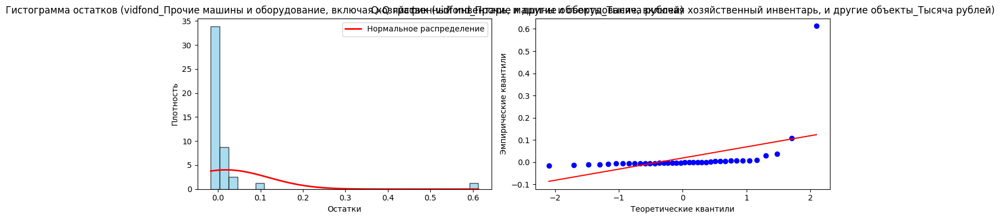


Анализ для mosh_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.692, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.215, p-значение = 0.051
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 3.027
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.581, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.064 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 11.557 (должно быть близко к 0 для нормального)


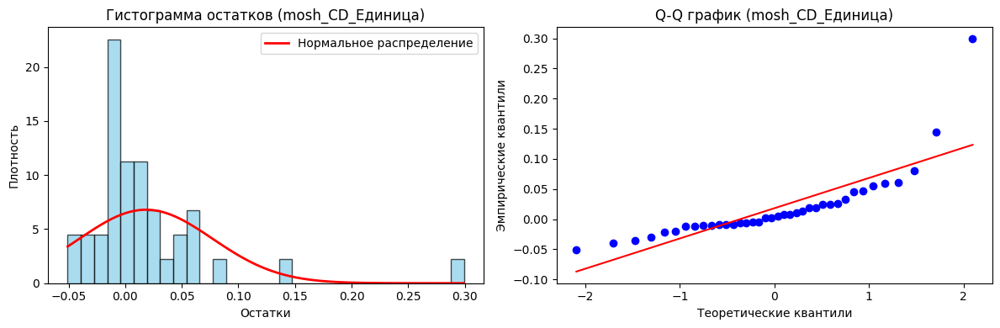


Анализ для gilsem_Всего_Единица:
Тест Шапиро-Уилка: статистика = 0.610, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.303, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.861
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 52.364, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.242 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 11.557 (должно быть близко к 0 для нормального)


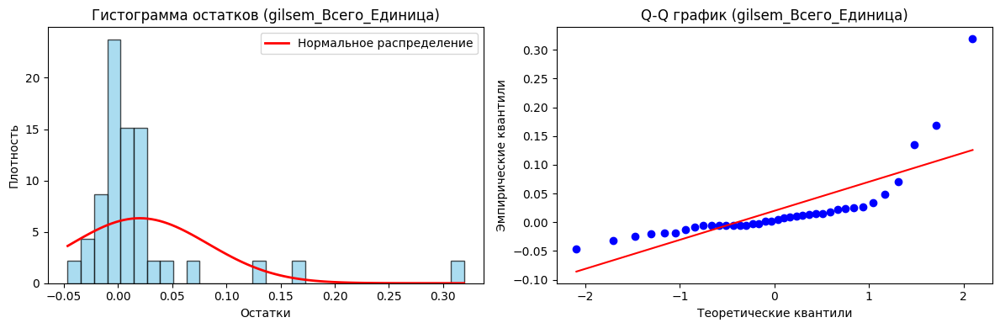


Анализ для sport_Плоскостные спортивные сооружения_Единица:
Тест Шапиро-Уилка: статистика = 0.478, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.297, p-значение = 0.002
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.634
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 74.819, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.704 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 24.185 (должно быть близко к 0 для

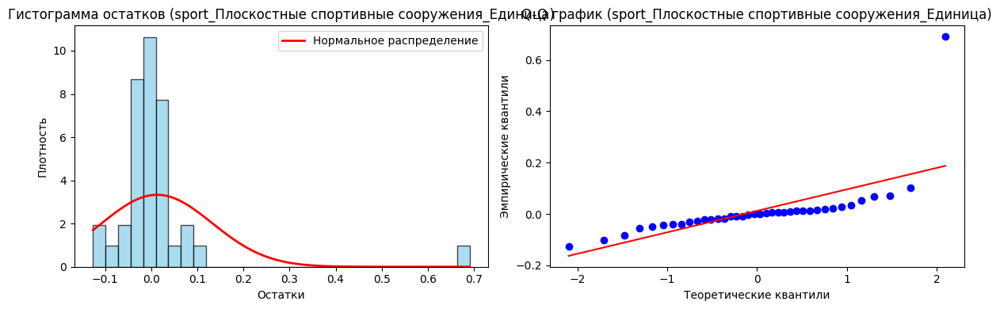


Анализ для sport_Спортивные залы_Единица:
Тест Шапиро-Уилка: статистика = 0.677, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.323, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.799
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 38.201, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.480 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.669 (должно быть близко к 0 для нормального)


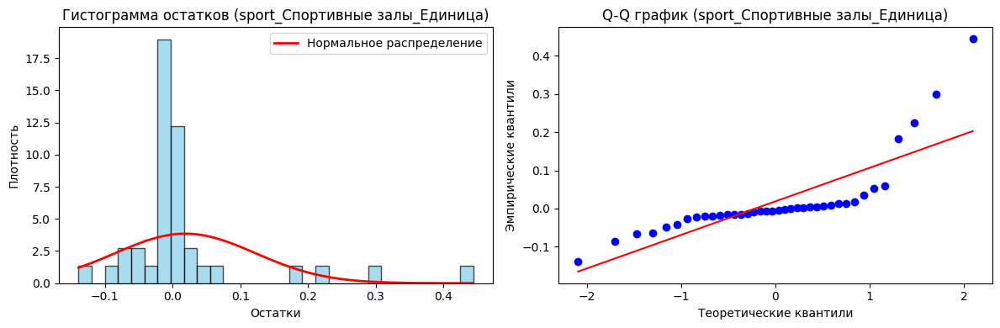


Анализ для sport_Спортивные сооружения — всего_Единица:
Тест Шапиро-Уилка: статистика = 0.520, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.326, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.387
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 53.234, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.393 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 10.982 (должно быть близко к 0 для нор

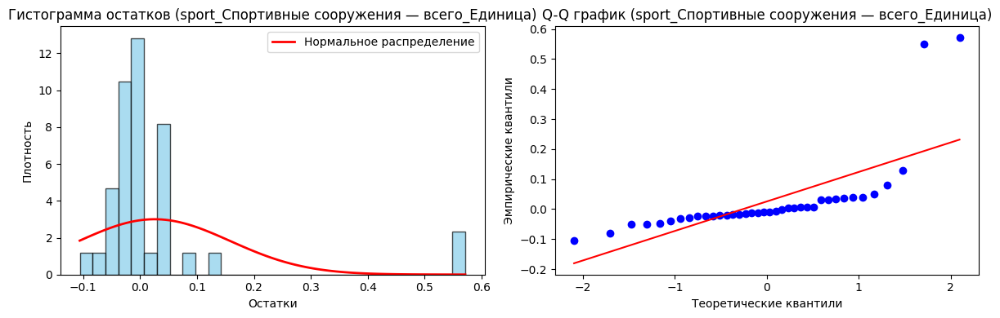


Анализ для vidres_CD_Человек:
Тест Шапиро-Уилка: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.819
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.137, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.825 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.831 (должно быть близко к 0 для нормального)


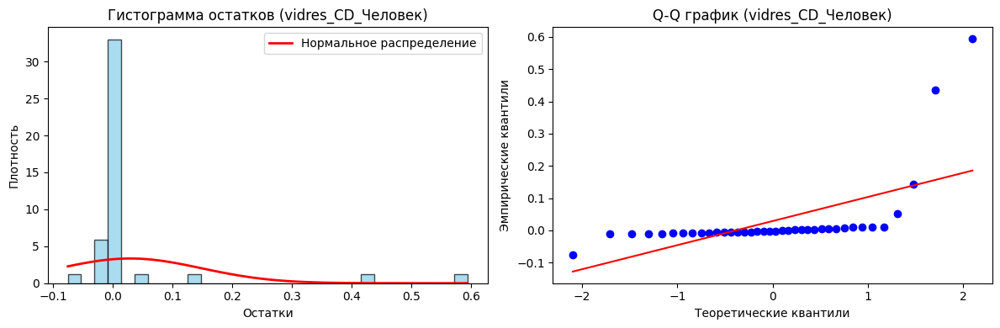


Анализ для mest_CD_Человек:
Тест Шапиро-Уилка: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.819
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.137, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.825 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.831 (должно быть близко к 0 для нормального)


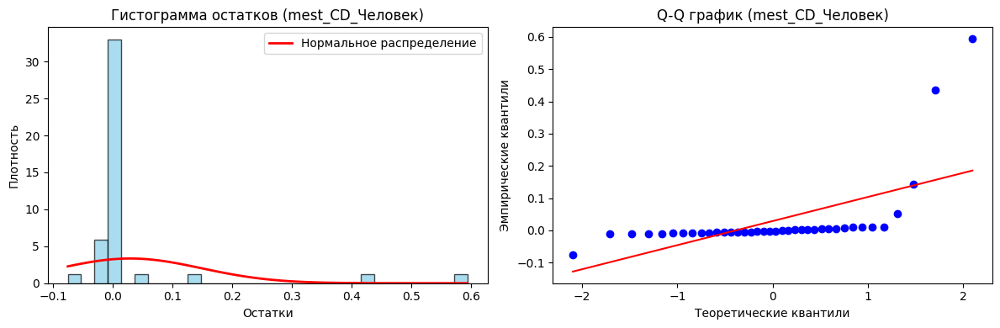


Анализ для okfs_CD_Человек:
Тест Шапиро-Уилка: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.454, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.819
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.137, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.825 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 13.831 (должно быть близко к 0 для нормального)


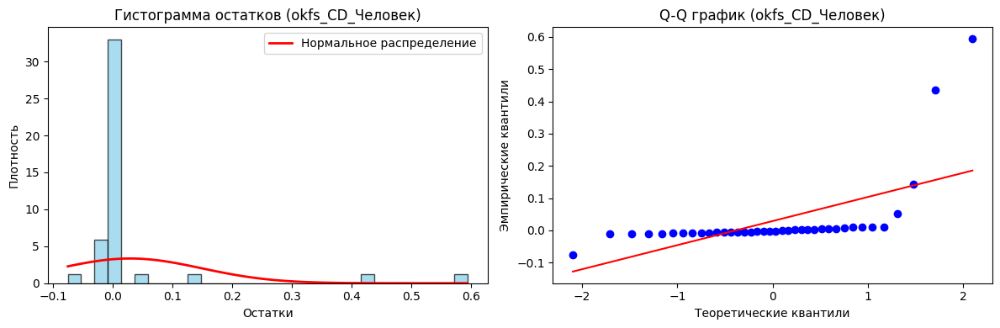


Анализ для vidazc_CD_Гектар:
Тест Шапиро-Уилка: статистика = 0.686, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.279, p-значение = 0.004
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.324
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 39.326, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.312 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.732 (должно быть близко к 0 для нормального)


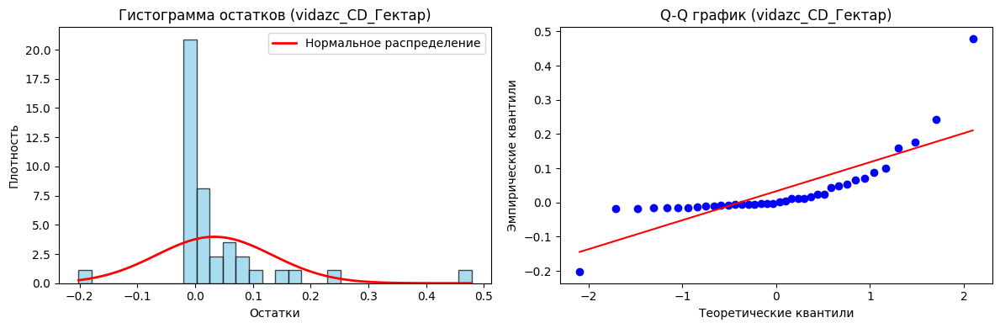


Анализ для vidazc_CD_Километр, тысяча метров:
Тест Шапиро-Уилка: статистика = 0.873, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.141, p-значение = 0.396
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 1.205
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 18.252, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.477 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.419 (должно быть близко к 0 для нормальног

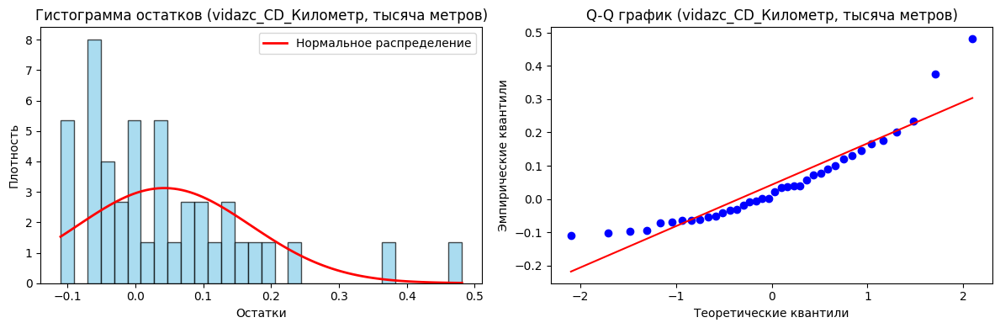


Анализ для pokdor_CD_Гектар:
Тест Шапиро-Уилка: статистика = 0.686, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.279, p-значение = 0.004
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.324
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 39.326, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.312 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.732 (должно быть близко к 0 для нормального)


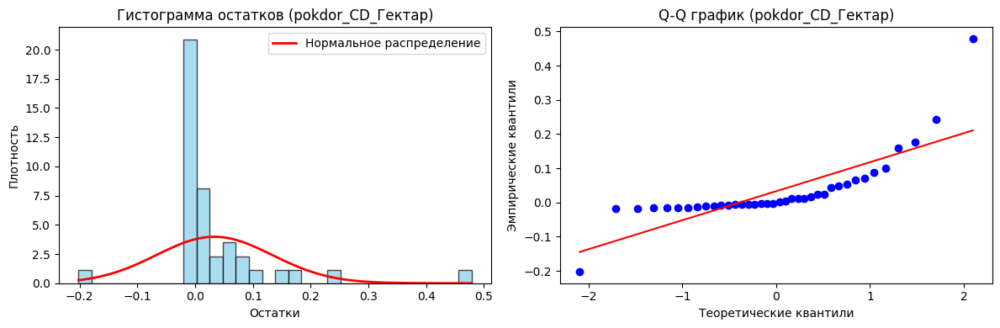


Анализ для pokdor_CD_Километр, тысяча метров:
Тест Шапиро-Уилка: статистика = 0.943, p-значение = 0.054
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Колмогорова-Смирнова: статистика = 0.134, p-значение = 0.465
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 0.735
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Нет оснований отвергать нормальность (статистика <= 0.844 при уровне значимости 2.5%)
  => Нет оснований отвергать нормальность (статистика <= 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 7.820, p-значение = 0.020
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 0.890 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 0.960 (должно быть близко к 0 для

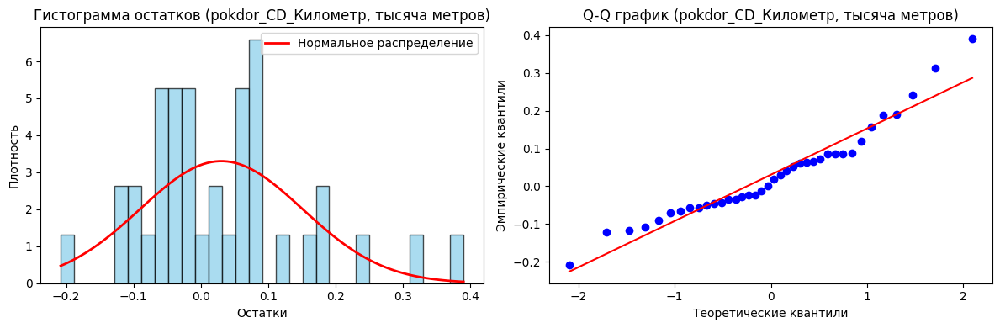


Анализ для pokdor_Всего_Километр, тысяча метров:
Тест Шапиро-Уилка: статистика = 0.920, p-значение = 0.010
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.128, p-значение = 0.524
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 0.825
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Нет оснований отвергать нормальность (статистика <= 0.844 при уровне значимости 2.5%)
  => Нет оснований отвергать нормальность (статистика <= 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 10.408, p-значение = 0.005
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.083 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 1.156 (должно быть близко к 0 для

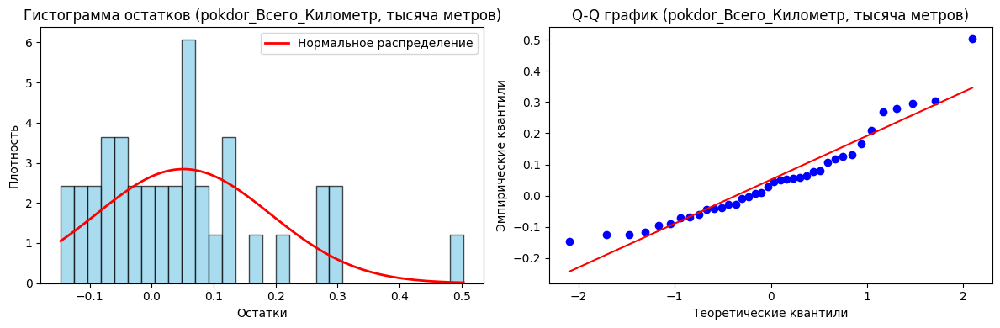


Анализ для pokdor_С твердым покрытием_Километр, тысяча метров:
Тест Шапиро-Уилка: статистика = 0.829, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.146, p-значение = 0.354
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 1.847
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 19.469, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.599 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.345 (должно быть близко к

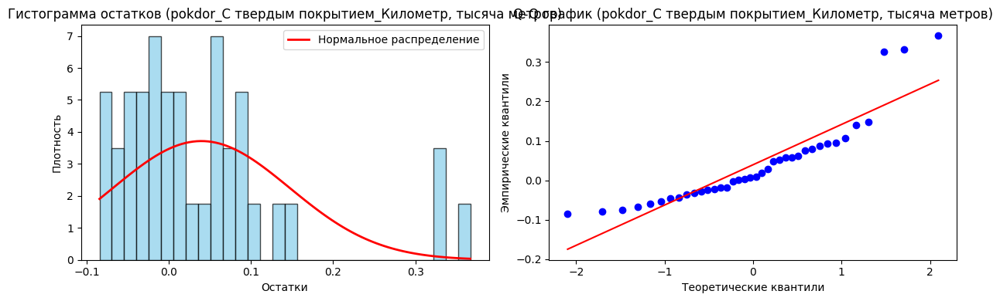


Анализ для tipset_CD_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.640, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.295, p-значение = 0.002
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.746
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 44.501, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.828 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.456 (должно быть бли

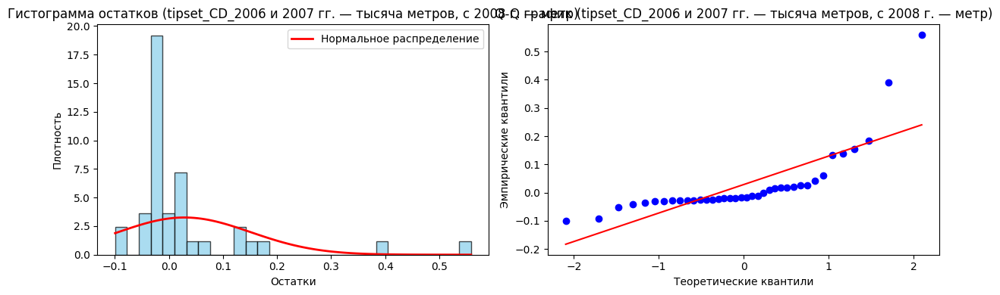


Анализ для tipset_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.808, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.223, p-значение = 0.039
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.681
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 19.955, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.644 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.331 (должно быть близко к 0 для нормального)


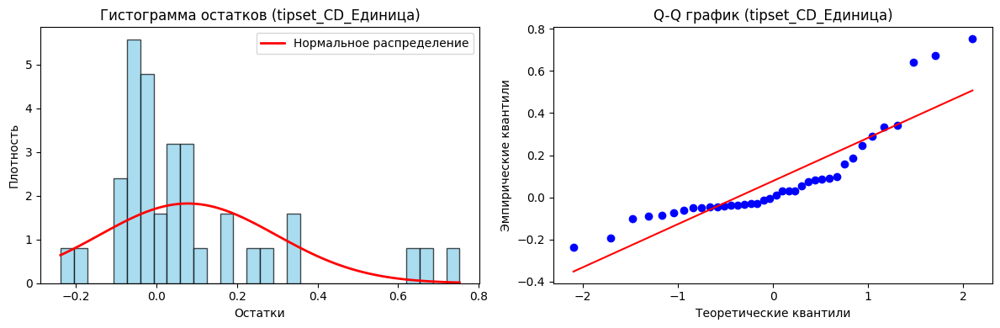


Анализ для tipset_Уличная водопроводная сеть_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.642, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.275, p-значение = 0.005
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 4.207
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 47.648, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.997 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis)

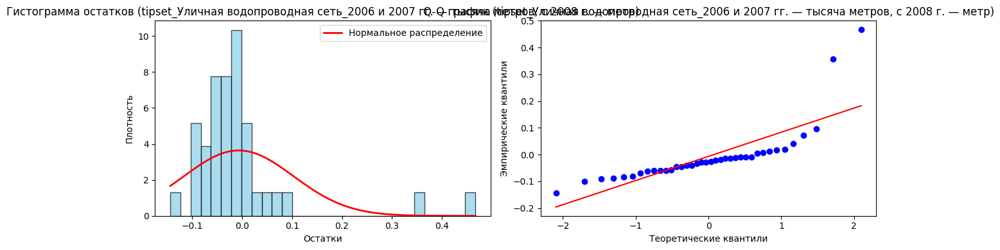


Анализ для tipset_Уличная водопроводная сеть, нуждающаяся в замене_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.529, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.352, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.597
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 51.571, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.259 (должно быть близко к 0 для нормально

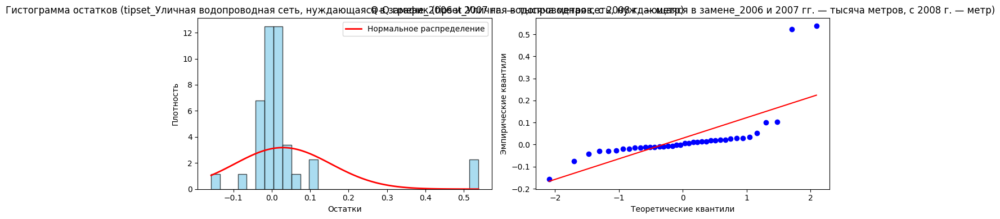


Анализ для schil_CD_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.564, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.318, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.754
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.067, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.189 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.959 (должно быть близ

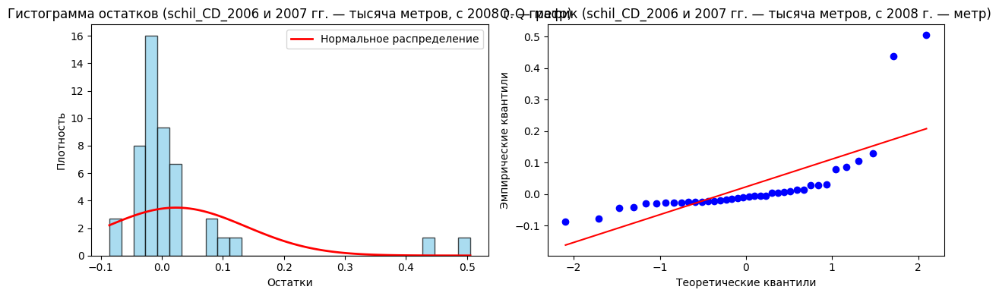


Анализ для schil_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.808, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.223, p-значение = 0.039
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.681
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 19.955, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.644 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.331 (должно быть близко к 0 для нормального)


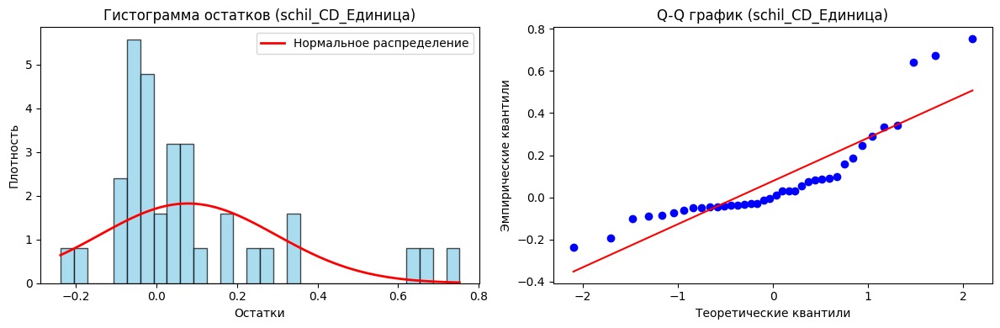


Анализ для mostep_CD_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.564, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.318, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.754
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.067, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.189 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.959 (должно быть бли

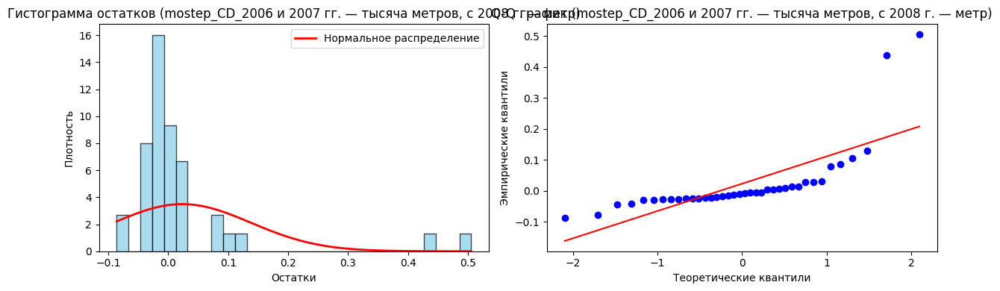


Анализ для mostep_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.780, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.226, p-значение = 0.035
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 3.096
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 22.129, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.767 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.632 (должно быть близко к 0 для нормального)


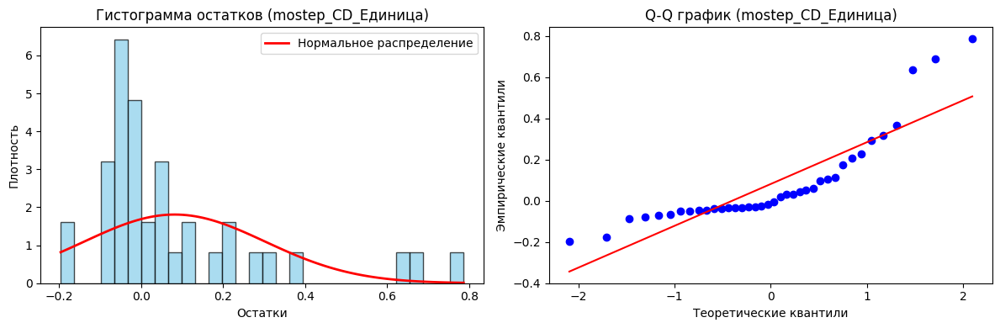


Анализ для mostep_Всего_Единица:
Тест Шапиро-Уилка: статистика = 0.813, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.221, p-значение = 0.042
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.254
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 30.930, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.961 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.770 (должно быть близко к 0 для нормального)


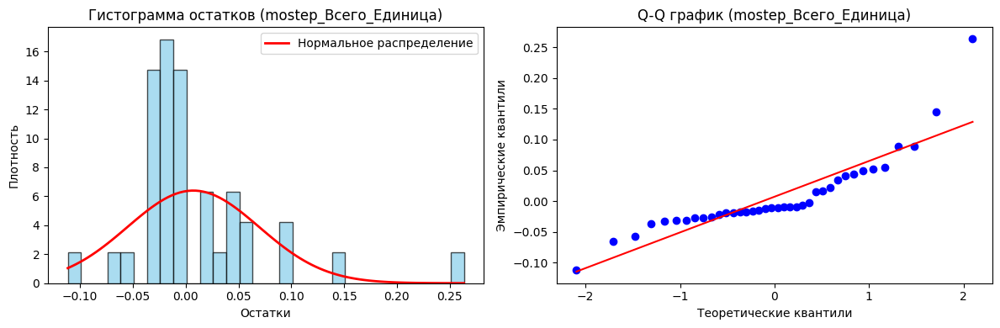


Анализ для kanal_CD_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.562, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.334, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.509
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 58.461, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.598 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 14.357 (должно быть бли

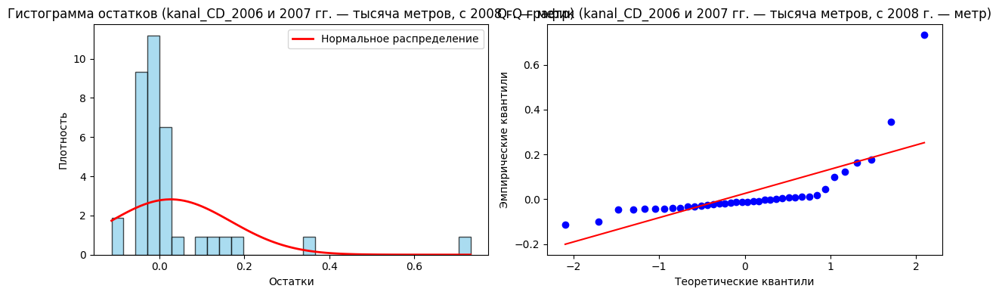


Анализ для kanal_CD_Единица:
Тест Шапиро-Уилка: статистика = 0.808, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.223, p-значение = 0.039
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 2.681
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 19.955, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 1.644 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 2.331 (должно быть близко к 0 для нормального)


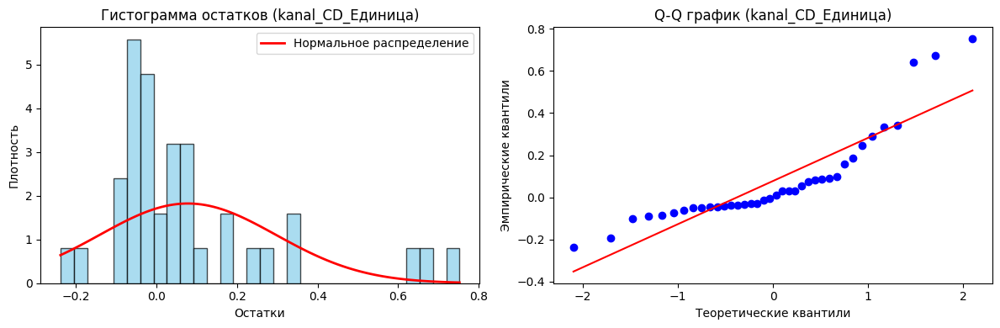


Анализ для kanal_Уличная канализационная сеть_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.477, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.316, p-значение = 0.001
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.131
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 71.284, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.469 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis

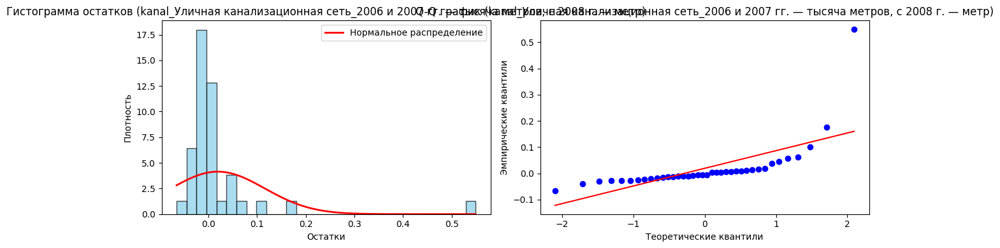


Анализ для kanal_Уличная канализационная, нуждающаяся в замене_2006 и 2007 гг. — тысяча метров, с 2008 г. — метр:
Тест Шапиро-Уилка: статистика = 0.574, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.349, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 5.494
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 57.169, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.508 (должно быть близко к 0 для нормального)


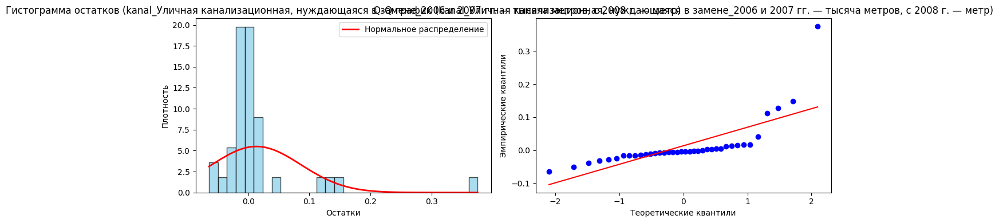


Анализ для istinv_Бюджетные средства_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.282, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.431, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 11.132
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 77.396, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.986 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 24.666 (должно быть близко к 0 для нормал

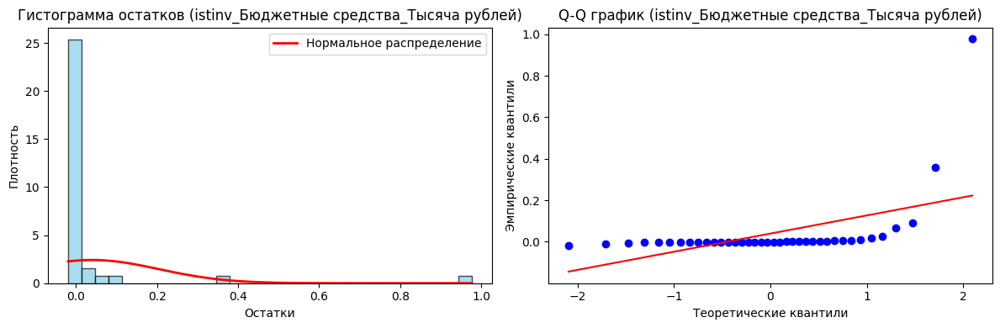


Анализ для istinv_Бюджетные средства из бюджетов субъектов Российской Федерации_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.260, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.450, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 11.002
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 83.224, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 5.455 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis)

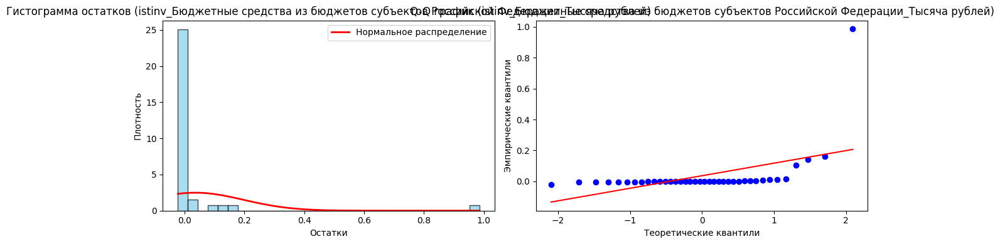


Анализ для istinv_Всего_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.440, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.456, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.687
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 43.955, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.903 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.507 (должно быть близко к 0 для нормального)


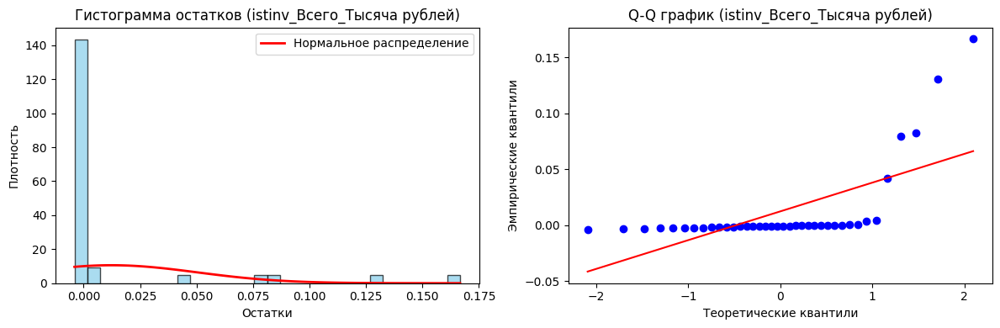


Анализ для istinv_Привлеченные средства_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.301, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.455, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 11.425
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 68.005, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.334 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 18.055 (должно быть близко к 0 для нор

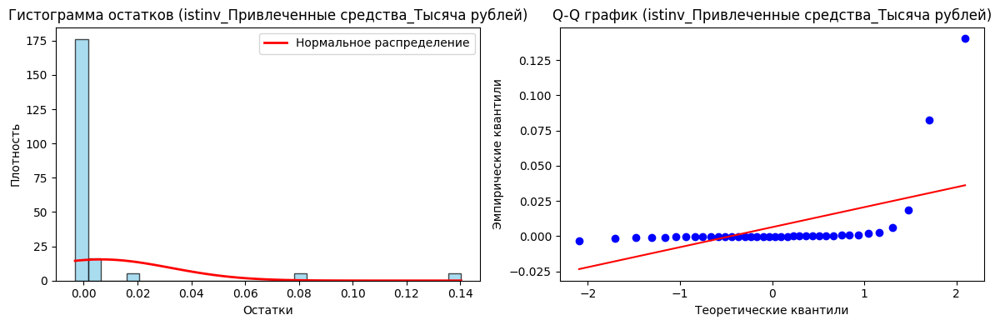


Анализ для istinv_Собственные средства_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.408, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.436, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.828
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.950, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.288 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.875 (должно быть близко к 0 для нормал

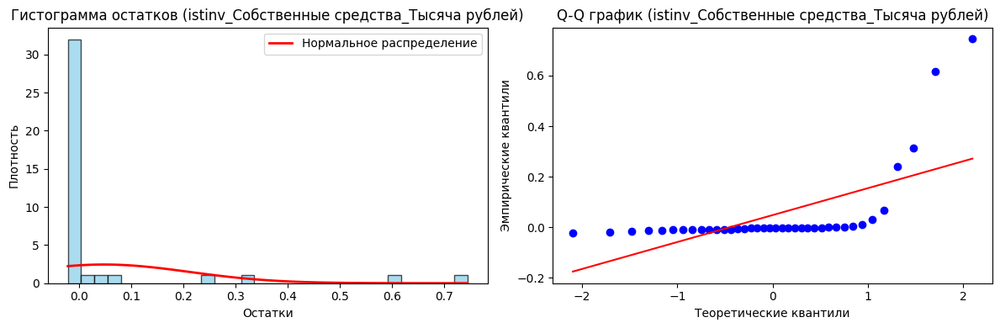


Анализ для istinv_Средства местного бюджета_Тысяча рублей:
Тест Шапиро-Уилка: статистика = 0.332, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.400, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.808
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 74.973, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 4.784 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 23.208 (должно быть близко к 0 для 

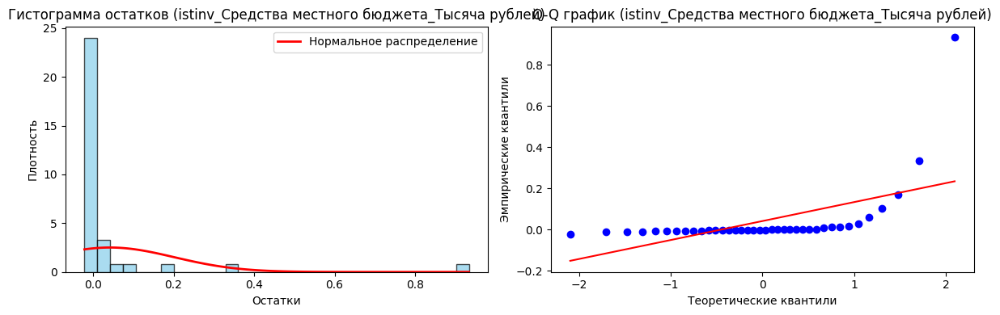


Анализ для grup_2_Всего_Человек:
Тест Шапиро-Уилка: статистика = 0.509, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.971
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 40.068, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.730 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.174 (должно быть близко к 0 для нормального)


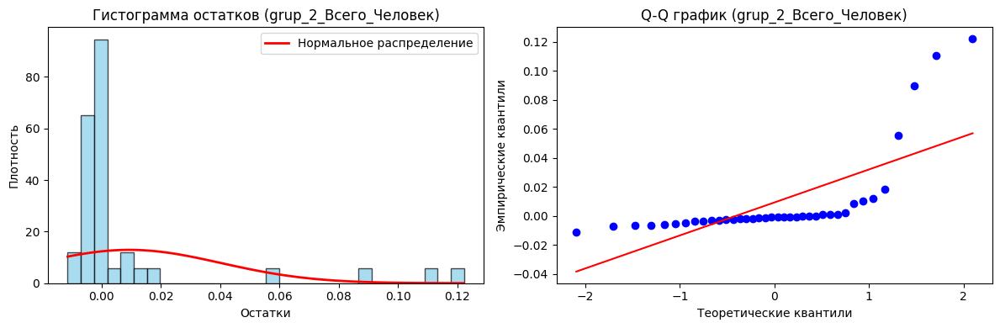


Анализ для grup_2_Женщины_Человек:
Тест Шапиро-Уилка: статистика = 0.504, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.385, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.086
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 40.521, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.749 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.329 (должно быть близко к 0 для нормального)


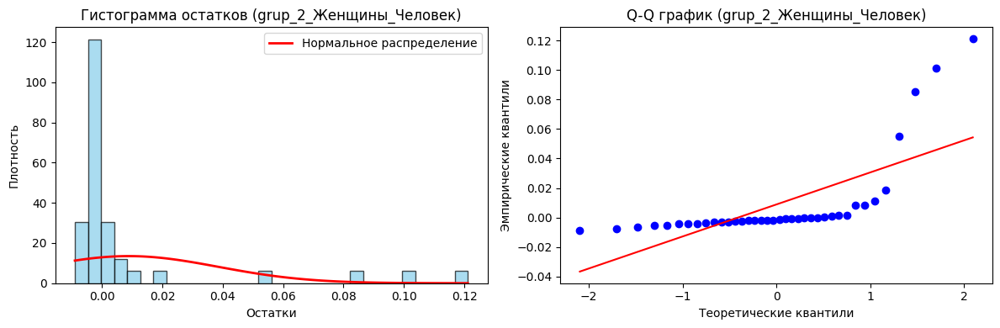


Анализ для grup_2_Мужчины_Человек:
Тест Шапиро-Уилка: статистика = 0.519, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.364, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.671
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 40.655, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.756 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.365 (должно быть близко к 0 для нормального)


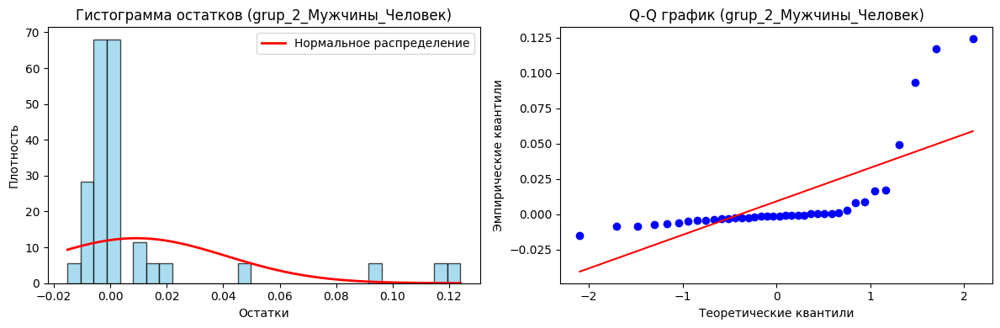


Анализ для migr_В пределах России_Человек:
Тест Шапиро-Уилка: статистика = 0.517, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.386, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.964
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 38.549, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.652 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 5.771 (должно быть близко к 0 для нормального)


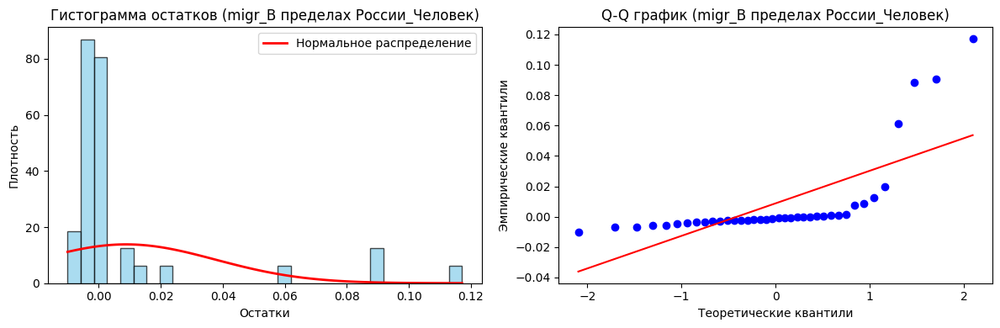


Анализ для migr_Внешняя (для региона) миграция_Человек:
Тест Шапиро-Уилка: статистика = 0.485, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.366, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.277
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 43.195, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.895 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.055 (должно быть близко к 0 для норм

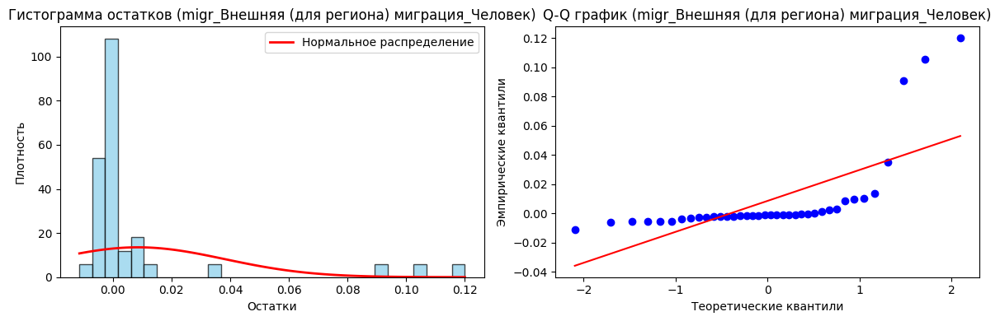


Анализ для migr_Внутрирегиональная_Человек:
Тест Шапиро-Уилка: статистика = 0.547, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.328, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.282
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 52.679, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.288 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 11.425 (должно быть близко к 0 для нормального)


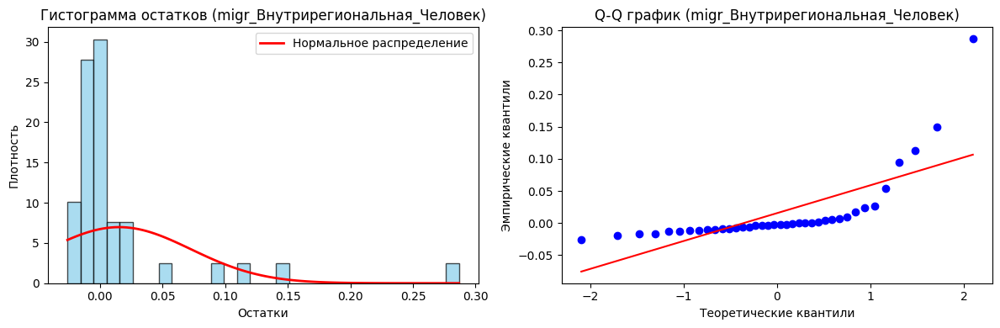


Анализ для migr_Международная_Человек:
Тест Шапиро-Уилка: статистика = 0.472, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.356, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.390
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 60.672, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.806 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 14.665 (должно быть близко к 0 для нормального)


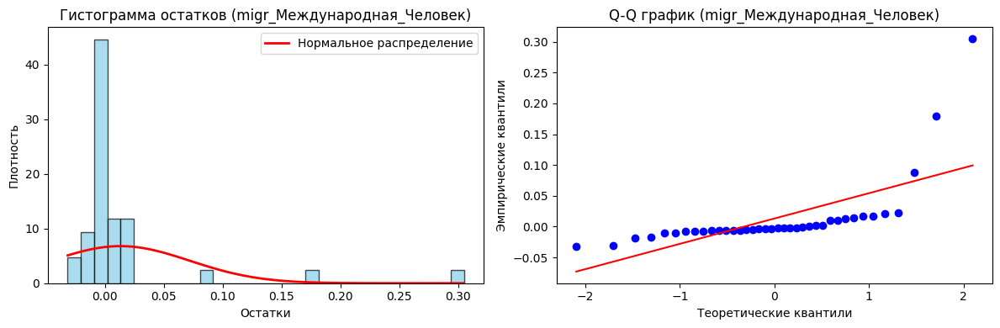


Анализ для migr_Межрегиональная_Человек:
Тест Шапиро-Уилка: статистика = 0.493, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.371, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.133
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 43.232, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.884 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 7.154 (должно быть близко к 0 для нормального)


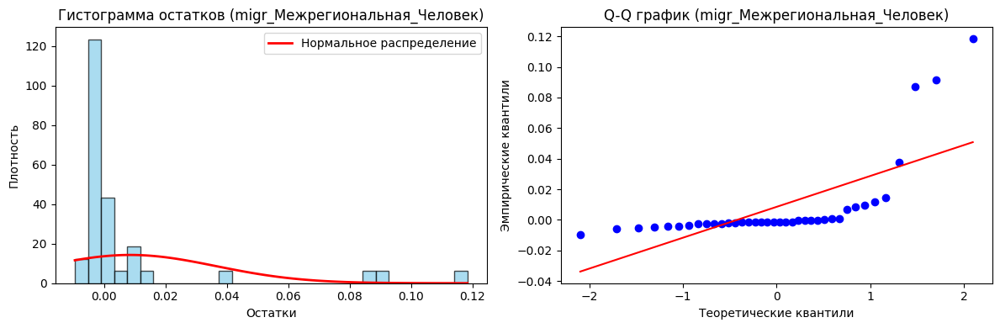


Анализ для migr_Миграция — всего_Человек:
Тест Шапиро-Уилка: статистика = 0.515, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.384, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.882
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 39.600, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.705 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 6.053 (должно быть близко к 0 для нормального)


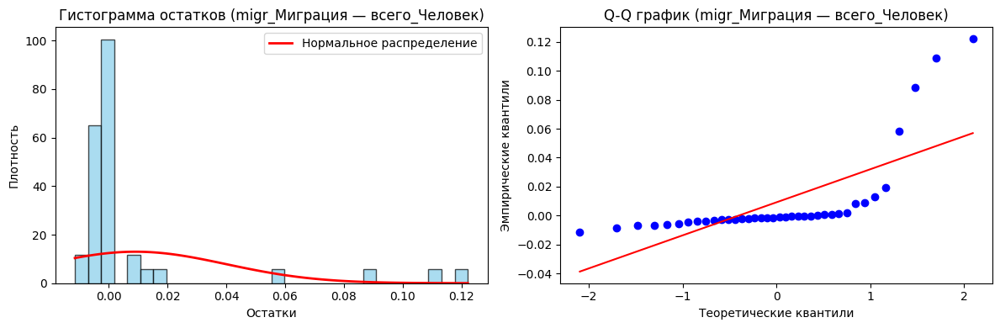


Анализ для migr_Со странами СНГ_Человек:
Тест Шапиро-Уилка: статистика = 0.474, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.358, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.406
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 59.690, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.748 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 14.142 (должно быть близко к 0 для нормального)


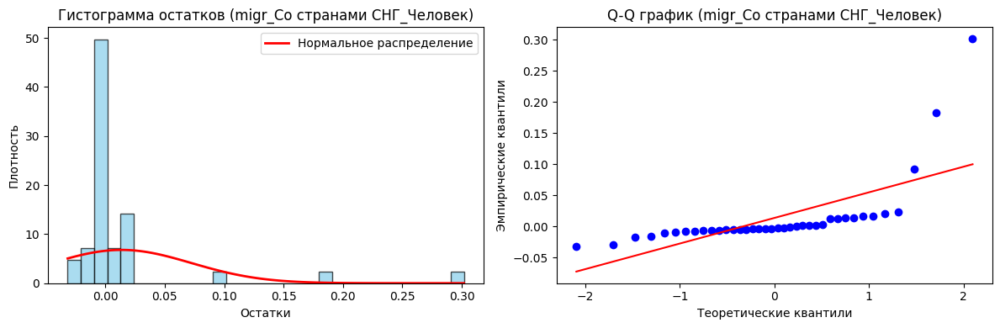


Анализ для wetwl_Всего_Рубль:
Тест Шапиро-Уилка: статистика = 0.753, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.253, p-значение = 0.012
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 3.502
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 29.837, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 2.067 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 4.540 (должно быть близко к 0 для нормального)


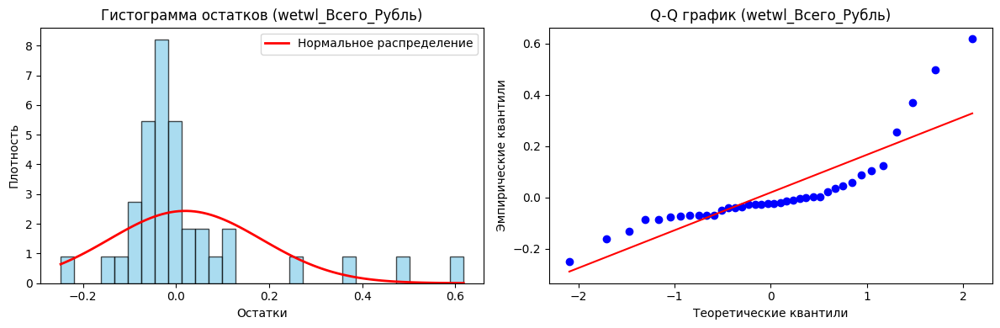


Анализ для wetwl_Всего_Человек:
Тест Шапиро-Уилка: статистика = 0.432, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.461, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.604
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.471, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.155 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.935 (должно быть близко к 0 для нормального)


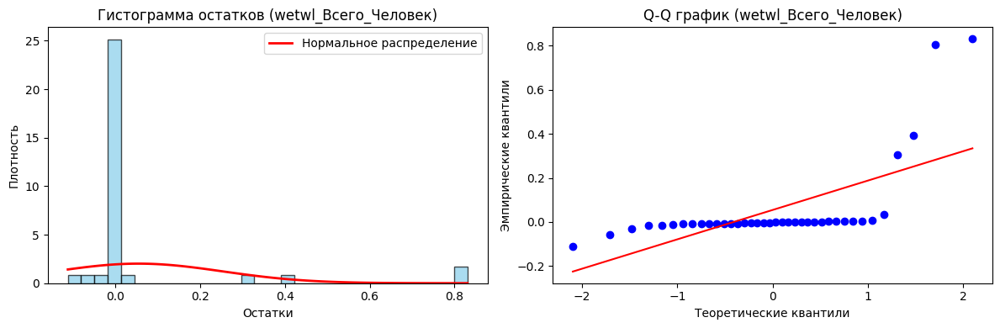


Анализ для okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Рубль:
Тест Шапиро-Уилка: статистика = 0.855, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.146, p-значение = 0.361
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 0.997
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Нет оснований отвергать нормальность (статистика <= 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 29.725, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): -1.757 (должно быть близко к 0 дл

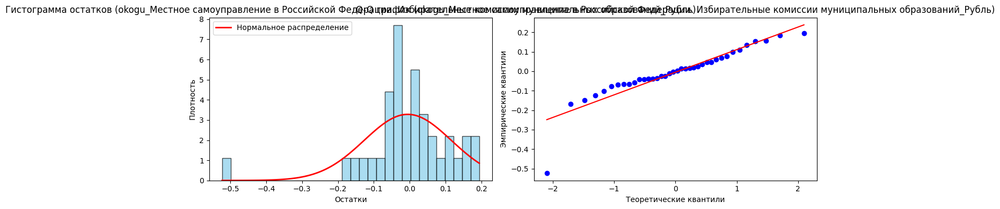


Анализ для okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Человек:
Тест Шапиро-Уилка: статистика = 0.432, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.461, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.604
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.471, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.155 (должно быть близко к 0 для норма

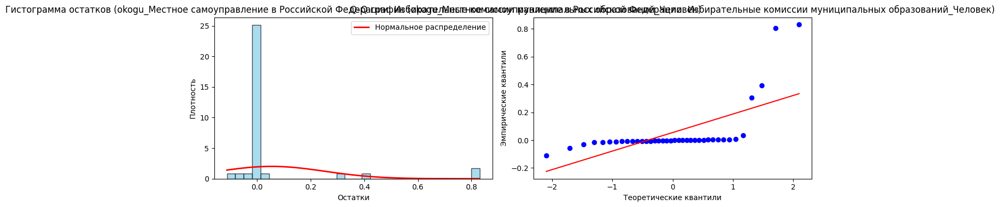


Анализ для okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Рубль:
Тест Шапиро-Уилка: статистика = 0.835, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.141, p-значение = 0.403
  => Нет оснований отвергать нормальность (p >= 0.05)
Тест Андерсона-Дарлинга: статистика = 1.231
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 33.430, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): -1.951 (должно быть близко к 0 для нормальног

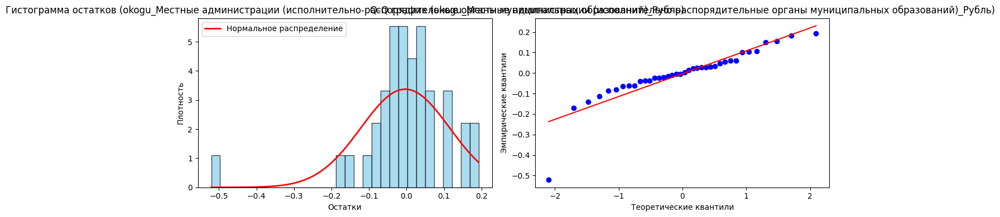


Анализ для okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Человек:
Тест Шапиро-Уилка: статистика = 0.427, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.460, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 9.638
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.990, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.187 (должно быть близко к 0 для нормального)


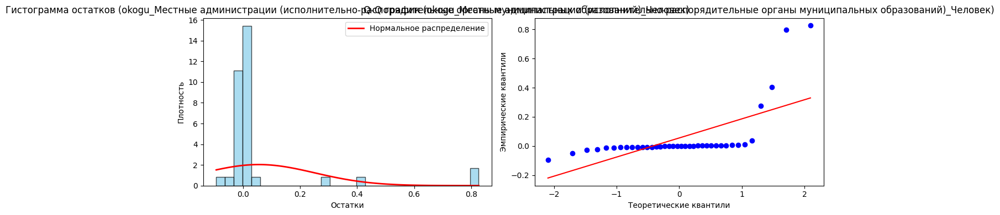


Анализ для stash_От 1 года до 5 лет_Человек:
Тест Шапиро-Уилка: статистика = 0.484, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.359, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 7.836
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.559, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.157 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.984 (должно быть близко к 0 для нормального)


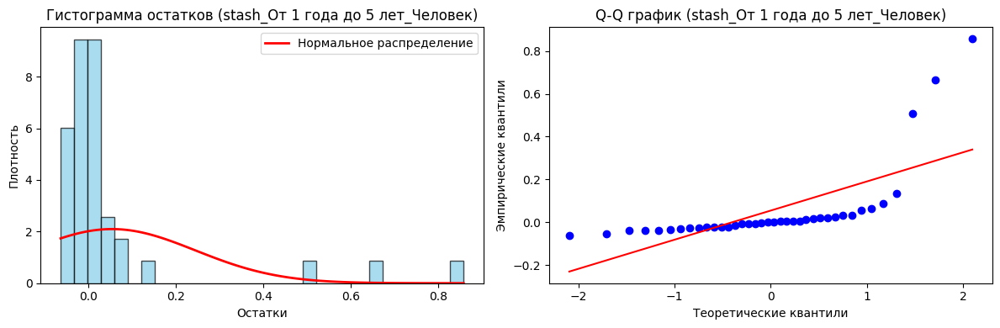


Анализ для stash_От 15 до 25 лет_Человек:
Тест Шапиро-Уилка: статистика = 0.468, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.434, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.355
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 50.685, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.268 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 9.810 (должно быть близко к 0 для нормального)


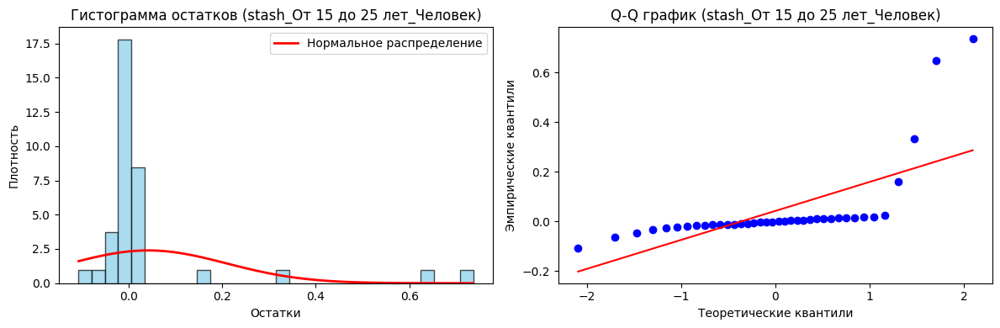


Анализ для stash_От 5 до 10 лет_Человек:
Тест Шапиро-Уилка: статистика = 0.480, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.424, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.175
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 48.332, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.139 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 8.951 (должно быть близко к 0 для нормального)


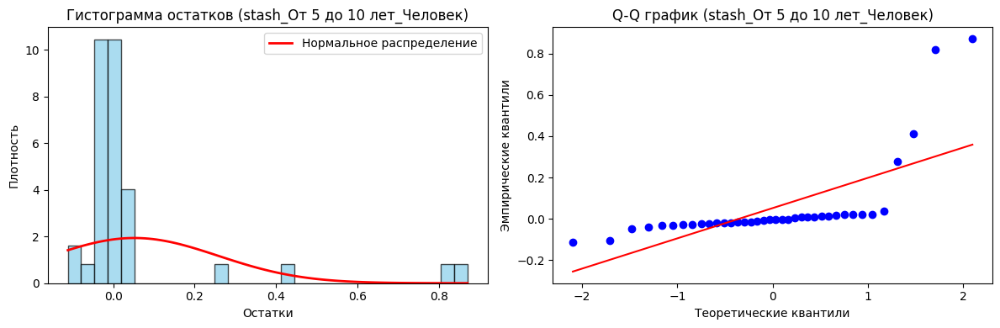


Анализ для okco_Науки об обществе_Человек:
Тест Шапиро-Уилка: статистика = 0.451, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.441, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 8.709
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 54.604, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.465 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 11.610 (должно быть близко к 0 для нормального)


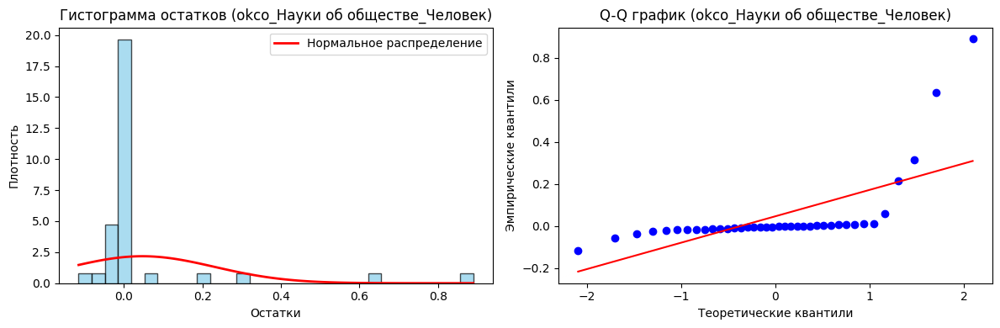


Анализ для okco_Экономика и управление_Человек:
Тест Шапиро-Уилка: статистика = 0.485, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Колмогорова-Смирнова: статистика = 0.394, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Тест Андерсона-Дарлинга: статистика = 6.991
  => Остатки НЕ распределены нормально (статистика > 0.529 при уровне значимости 15.0%)
  => Остатки НЕ распределены нормально (статистика > 0.603 при уровне значимости 10.0%)
  => Остатки НЕ распределены нормально (статистика > 0.723 при уровне значимости 5.0%)
  => Остатки НЕ распределены нормально (статистика > 0.844 при уровне значимости 2.5%)
  => Остатки НЕ распределены нормально (статистика > 1.004 при уровне значимости 1.0%)
Тест Д’Агостино K²: статистика = 62.731, p-значение = 0.000
  => Остатки НЕ распределены нормально (p < 0.05)
Асимметрия (Skewness): 3.909 (должно быть близко к 0 для нормального)
Эксцесс (Kurtosis): 16.035 (должно быть близко к 0 для нормального

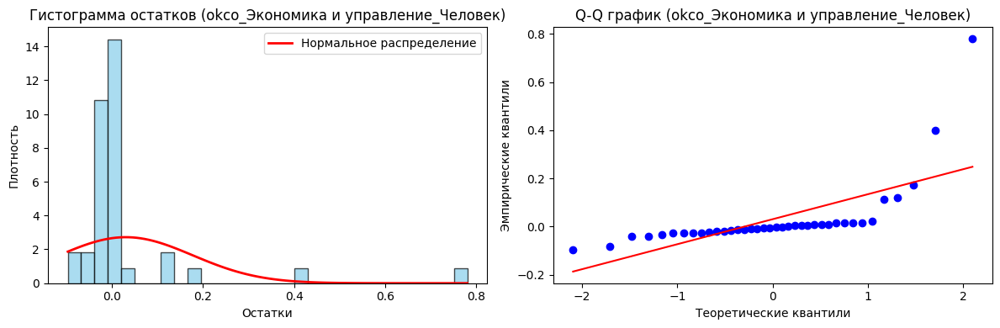

In [36]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.stats as stats
from scipy.stats import shapiro, kstest, anderson, normaltest
from scipy.stats import skew, kurtosis
import pandas as pd

def check_residuals_normality(y_test, y_pred, column=None):
    """
    Проверяет нормальность остатков для выбранной колонки или всех колонок с использованием
    визуальных методов и статистических тестов.
    
    Parameters:
    - y_test: Истинные значения (Pandas DataFrame, Series или NumPy массив).
    - y_pred: Предсказанные значения (Pandas DataFrame, Series или NumPy массив).
    - column: Имя или индекс колонки для анализа (по умолчанию None — все колонки).
    """
    
    # Преобразуем y_test и y_pred в массивы NumPy
    if hasattr(y_test, 'to_numpy'):
        y_test_np = y_test.to_numpy()
    else:
        y_test_np = np.array(y_test)

    if hasattr(y_pred, 'to_numpy'):
        y_pred_np = y_pred.to_numpy()
    else:
        y_pred_np = np.array(y_pred)

    # Проверяем соответствие размеров
    assert y_test_np.shape == y_pred_np.shape, f"Несоответствие форм: y_test {y_test_np.shape} != y_pred {y_pred_np.shape}"

    # Определяем количество колонок
    n_outputs = y_test_np.shape[1] if y_test_np.ndim > 1 else 1

    # Определяем имена колонок
    if hasattr(y_test, 'columns'):
        column_names = list(y_test.columns)
    else:
        column_names = [f'Целевая переменная {i+1}' for i in range(n_outputs)]

    # Выбор колонки
    if column is not None:
        if isinstance(column, str):
            if column not in column_names:
                raise ValueError(f"Колонка '{column}' не найдена. Доступные колонки: {column_names}")
            col_idx = column_names.index(column)
        elif isinstance(column, int):
            if column < 0 or column >= n_outputs:
                raise ValueError(f"Индекс колонки {column} вне диапазона [0, {n_outputs-1}]")
            col_idx = column
        else:
            raise ValueError("Параметр column должен быть строкой (имя колонки) или целым числом (индекс)")
        
        # Фильтруем данные для выбранной колонки
        y_test_np = y_test_np[:, col_idx:col_idx+1] if y_test_np.ndim > 1 else y_test_np[:, None]
        y_pred_np = y_pred_np[:, col_idx:col_idx+1] if y_pred_np.ndim > 1 else y_pred_np[:, None]
        column_names = [column_names[col_idx]]
        n_outputs = 1
    else:
        col_idx = None  # Анализируем все колонки

    # Рассчитываем остатки
    residuals = y_test_np - y_pred_np

    # Проверка нормальности для каждой целевой переменной
    for i in range(n_outputs):
        print(f'\nАнализ для {column_names[i]}:')

        # Извлекаем остатки для текущей колонки
        res = residuals[:, i]

        # 1. Тест Шапиро-Уилка
        stat, p_value = shapiro(res)
        print(f'Тест Шапиро-Уилка: статистика = {stat:.3f}, p-значение = {p_value:.3f}')
        if p_value < 0.05:
            print('  => Остатки НЕ распределены нормально (p < 0.05)')
        else:
            print('  => Нет оснований отвергать нормальность (p >= 0.05)')

        # 2. Тест Колмогорова-Смирнова
        stat, p_value = kstest(res, 'norm', args=(np.mean(res), np.std(res)))
        print(f'Тест Колмогорова-Смирнова: статистика = {stat:.3f}, p-значение = {p_value:.3f}')
        if p_value < 0.05:
            print('  => Остатки НЕ распределены нормально (p < 0.05)')
        else:
            print('  => Нет оснований отвергать нормальность (p >= 0.05)')

        # 3. Тест Андерсона-Дарлинга
        result = anderson(res, dist='norm')
        print(f'Тест Андерсона-Дарлинга: статистика = {result.statistic:.3f}')
        for crit_val, sig_level in zip(result.critical_values, result.significance_level):
            if result.statistic > crit_val:
                print(f'  => Остатки НЕ распределены нормально (статистика > {crit_val:.3f} при уровне значимости {sig_level}%)')
            else:
                print(f'  => Нет оснований отвергать нормальность (статистика <= {crit_val:.3f} при уровне значимости {sig_level}%)')

        # 4. Тест Д’Агостино K²
        stat, p_value = normaltest(res)
        print(f'Тест Д’Агостино K²: статистика = {stat:.3f}, p-значение = {p_value:.3f}')
        if p_value < 0.05:
            print('  => Остатки НЕ распределены нормально (p < 0.05)')
        else:
            print('  => Нет оснований отвергать нормальность (p >= 0.05)')

        # 5. Асимметрия и эксцесс
        skewness = skew(res)
        kurt = kurtosis(res, fisher=True)
        print(f'Асимметрия (Skewness): {skewness:.3f} (должно быть близко к 0 для нормального)')
        print(f'Эксцесс (Kurtosis): {kurt:.3f} (должно быть близко к 0 для нормального)')

        # 6. Визуализация
        plt.figure(figsize=(12, 4))

        # Гистограмма остатков
        plt.subplot(1, 2, 1)
        plt.hist(res, bins=30, alpha=0.7, color='skyblue', edgecolor='black', density=True)
        # Добавляем кривую нормального распределения
        mu, sigma = np.mean(res), np.std(res)
        x = np.linspace(min(res), max(res), 100)
        plt.plot(x, stats.norm.pdf(x, mu, sigma), 'r-', lw=2, label='Нормальное распределение')
        plt.title(f'Гистограмма остатков ({column_names[i]})')
        plt.xlabel('Остатки')
        plt.ylabel('Плотность')
        plt.legend()

        # Q-Q график
        plt.subplot(1, 2, 2)
        stats.probplot(res, dist="norm", plot=plt)
        plt.title(f'Q-Q график ({column_names[i]})')
        plt.xlabel('Теоретические квантили')
        plt.ylabel('Эмпирические квантили')

        plt.tight_layout()
        plt.show()

# Пример использования
# Если y_test — DataFrame, можно выбрать по имени:
# check_residuals_normality(y_test, y_pred, column='target_1')

# Если y_test — NumPy массив, выбираем по индексу:
# check_residuals_normality(y_test, y_pred, column=0)

# Для всех колонок:
check_residuals_normality(y_test, y_pred)

Общая средняя важность признаков:
                  mean_importance
population               0.352653
living_area              0.176148
build_floor_area         0.098972
site_area                0.073665
residential              0.059080
special                  0.055254
footprint_area           0.052078
industrial               0.041881
recreation               0.040601
non_living_area          0.040233


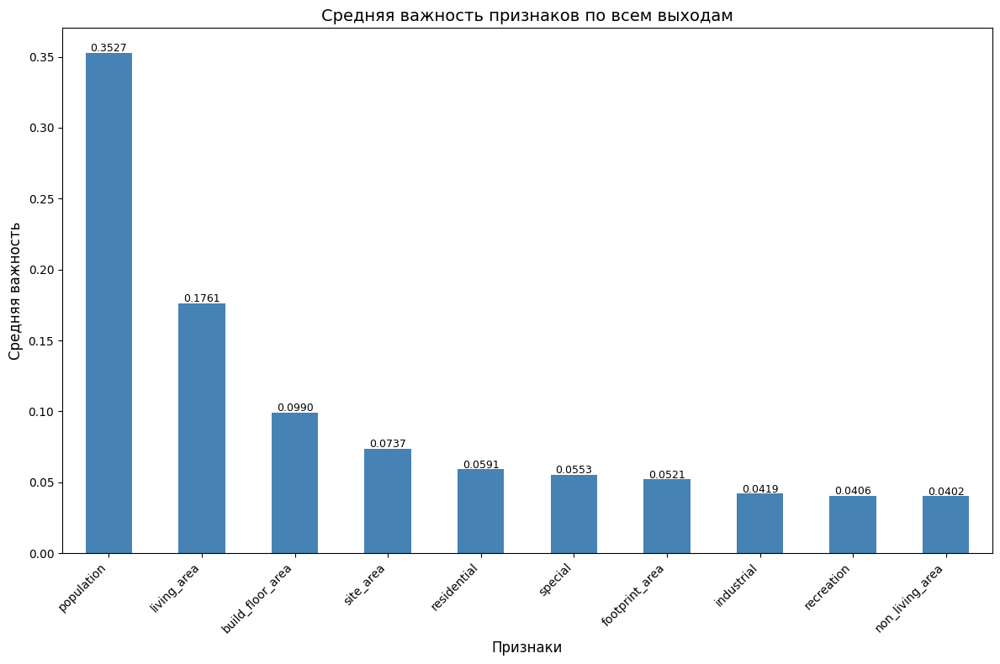

In [37]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns


# Получение важности признаков
feature_importances = []
feature_names = X_train.columns if hasattr(X_train, 'columns') else [f"feature_{i}" for i in range(X_train.shape[1])]
output_names = y_train.columns if hasattr(y_train, 'columns') else [f"target_{i}" for i in range(y_train.shape[1])]

for i, estimator in enumerate(best_multi_gbr.estimators_):
    # Для каждого отдельного регрессора
    importances = estimator.feature_importances_
    feature_importances.append(importances)
    
    # Вывод важности для каждого выхода
    target_name = output_names[i]


feature_importance_df = pd.DataFrame(
    np.array(feature_importances).T,
    index=feature_names,
    columns=output_names
)

# Средняя важность по всем выходам
feature_importance_df['mean_importance'] = feature_importance_df.mean(axis=1)
feature_importance_df = feature_importance_df.sort_values('mean_importance', ascending=False)

print("Общая средняя важность признаков:")
print(feature_importance_df[['mean_importance']])

# Визуализация средней важности признаков
plt.figure(figsize=(12, 8))
ax = feature_importance_df['mean_importance'].plot(kind='bar', color='steelblue')
plt.title('Средняя важность признаков по всем выходам', fontsize=14)
plt.ylabel('Средняя важность', fontsize=12)
plt.xlabel('Признаки', fontsize=12)
plt.xticks(rotation=45, ha='right')
plt.tight_layout()

# Добавляем значения над столбцами
for i, v in enumerate(feature_importance_df['mean_importance']):
    ax.text(i, v + 0.001, f'{v:.4f}', ha='center', fontsize=9)

plt.show()

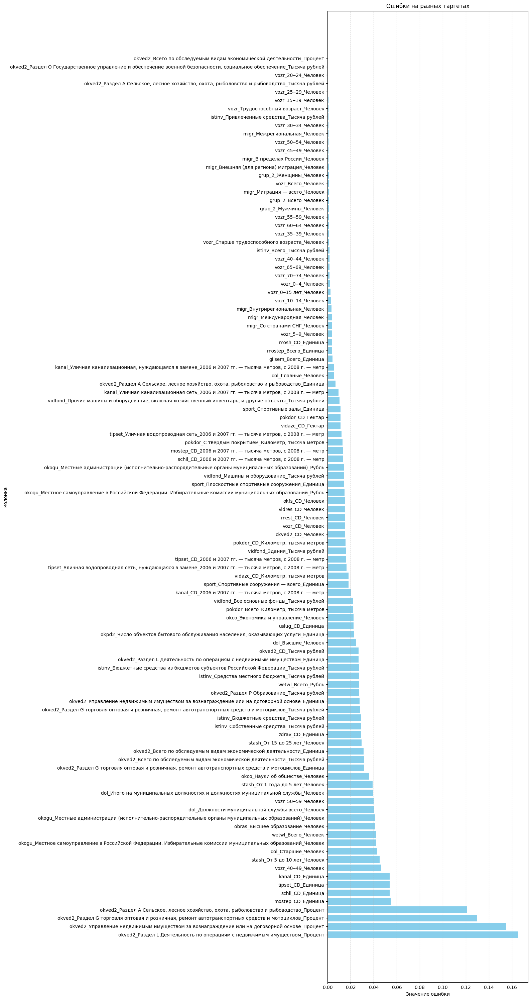

In [39]:
import matplotlib.pyplot as plt
import numpy as np

# Предположим, что mse — список значений ошибок, а Y.columns — список названий колонок
# Сортируем по убыванию
sorted_indices = np.argsort(mse)[::-1]
sorted_mse = np.array(mse)[sorted_indices]
sorted_columns = np.array(Y.columns)[sorted_indices]

# Построение горизонтальной гистограммы
plt.figure(figsize=(16, 30))
plt.barh(sorted_columns, sorted_mse, color='skyblue')

# Добавим подписи и заголовок
plt.ylabel('Колонка')
plt.xlabel('Значение ошибки')
plt.title('Ошибки на разных таргетах')

# Сетка и отображение
plt.grid(axis='x', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


In [41]:
y_train

,zdrav_CD_Единица,uslug_CD_Единица,"okpd2_Число объектов бытового обслуживания населения, оказывающих услуги_Единица",okved2_CD_Тысяча рублей,okved2_CD_Человек,okved2_Всего по обследуемым видам экономической деятельности_Единица,okved2_Всего по обследуемым видам экономической деятельности_Процент,okved2_Всего по обследуемым видам экономической деятельности_Тысяча рублей,"okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Единица","okved2_Раздел G торговля оптовая и розничная, ремонт автотранспортных средств и мотоциклов_Процент",...,wetwl_Всего_Человек,okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Рубль,okogu_Местное самоуправление в Российской Федерации. Избирательные комиссии муниципальных образований_Человек,okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Рубль,okogu_Местные администрации (исполнительно-распорядительные органы муниципальных образований)_Человек,stash_От 1 года до 5 лет_Человек,stash_От 15 до 25 лет_Человек,stash_От 5 до 10 лет_Человек,okco_Науки об обществе_Человек,okco_Экономика и управление_Человек
41,0.088889,0.053452,0.036117,0.000161,0.079946,0.099408,0.0,0.005147,0.060811,1.0,...,0.078785,0.856443,0.078785,0.861099,0.075224,0.14,0.046512,0.101449,0.054545,0.061947
109,0.111111,0.164811,0.167043,0.006573,0.256090,0.139566,0.0,0.099356,0.131757,1.0,...,0.091960,0.550346,0.091960,0.545397,0.092002,0.06,0.093023,0.101449,0.100000,0.123894
115,0.022222,0.042316,0.042889,0.007923,0.129334,0.097433,0.0,0.009348,0.047297,1.0,...,0.045711,0.512564,0.045711,0.497423,0.044463,0.06,0.023256,0.043478,0.027273,0.035398
83,0.088889,0.008909,0.009029,0.011468,0.097568,0.051350,0.0,0.003963,0.020270,1.0,...,0.046518,0.520978,0.046518,0.522494,0.048378,0.06,0.046512,0.028986,0.050000,0.061947
103,0.400000,0.712695,0.681716,0.051008,0.512774,0.310072,0.0,0.269638,0.391892,1.0,...,0.535628,0.476771,0.535628,0.472778,0.542785,0.32,0.558140,0.420290,0.463636,0.725664
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,0.066667,0.011136,0.011287,0.000685,0.017632,0.010533,0.0,0.001280,0.003378,1.0,...,0.014251,0.480095,0.014251,0.481492,0.014821,0.04,0.000000,0.000000,0.018182,0.026549
19,0.088889,0.073497,0.074492,0.003211,0.129436,0.038183,0.0,0.026547,0.047297,1.0,...,0.073138,0.466945,0.073138,0.468304,0.076063,0.20,0.011628,0.057971,0.040909,0.061947
102,0.044444,0.004454,0.002257,0.002302,0.009849,0.003292,0.0,0.000176,0.000000,0.0,...,0.024738,0.267017,0.024738,0.267794,0.025727,0.04,0.000000,0.028986,0.031818,0.053097
199,0.044444,0.020045,0.020316,0.003281,0.113246,0.030283,0.0,0.005326,0.023649,1.0,...,0.057811,0.619554,0.057811,0.590907,0.054810,0.08,0.034884,0.115942,0.018182,0.000000


In [45]:
import numpy as np
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from lime.lime_tabular import LimeTabularExplainer

# Разделение данных
X_train, X_test, y_train, y_test = train_test_split(X, Y, test_size=0.2, random_state=42)
y_train = y_train.fillna(0)
# Базовая модель GradientBoostingRegressor
gbr = GradientBoostingRegressor(random_state=42)

# Обучение модели
gbr.fit(X_train, y_train['dol_Старшие_Человек'])

# Пример предсказания
y_pred = gbr.predict(X_test)

# Оценка качества
mse = mean_squared_error(y_test['dol_Старшие_Человек'], y_pred)
print(f'Mean Squared Error: {mse:.3f}')

# Создание LIME объяснителя для табличных данных
explainer = LimeTabularExplainer(
    training_data=X_train.values,  # Преобразуем DataFrame в numpy массив
    feature_names=X_train.columns,  # Указываем имена признаков
    class_names=[str(i) for i in range(y_train.shape[1])],  # Если многовыходная регрессия
    mode='regression',  # Тип задачи: регрессия
    random_state=42
)

# Выбираем одно наблюдение для интерпретации (например, первое из теста)
i = 0
instance = X_test.iloc[i].values.reshape(1, -1)

# Получаем объяснение для выбранного примера
explanation = explainer.explain_instance(instance[0], gbr.predict)

# Если нужно просто вывести данные:
print("Predicted value:", y_pred[i])
print('Real value:', y_test['dol_Старшие_Человек'].iloc[0])
print("Explanation:")
print(explanation.as_list())

Mean Squared Error: 0.043
Predicted value: 0.017092079164380793
Real value: 0.026666666666666665
Explanation:
[('0.02 < population <= 0.04', -0.0782357290608524), ('recreation <= 0.00', -0.03006280992735558), ('0.00 < living_area <= 0.01', -0.0137772806220926), ('0.13 < residential <= 0.23', 0.009131383715205492), ('0.00 < special <= 0.00', 0.008369961624657857), ('0.03 < build_floor_area <= 0.06', 0.007006396883845559), ('0.06 < non_living_area <= 0.12', -0.006407501032282177), ('0.01 < site_area <= 0.05', -0.004910687337031602), ('0.03 < industrial <= 0.10', 0.002920412236912262), ('0.07 < footprint_area <= 0.13', 0.00026620507385965585)]


/root/blocksnet/.venv/lib/python3.12/site-packages/sklearn/utils/validation.py:2739: UserWarning: X does not have valid feature names, but GradientBoostingRegressor was fitted with feature names
  warnings.warn(


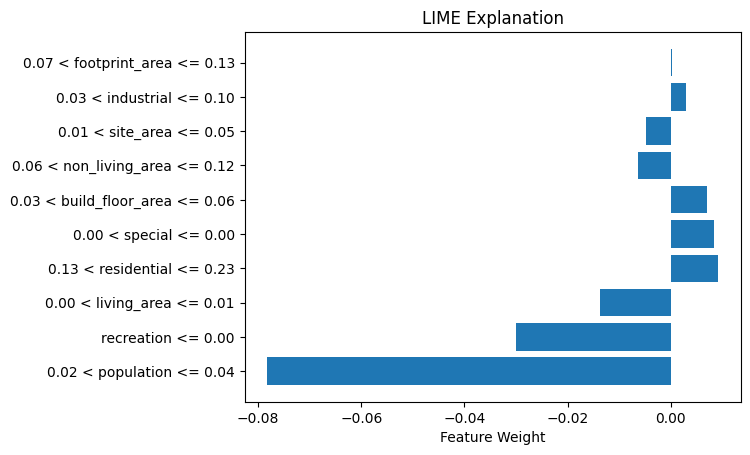

In [46]:
import matplotlib.pyplot as plt

# Получаем объяснение как список
explanation_list = explanation.as_list()

# Разбиваем объяснение на признаки и веса
features, weights = zip(*explanation_list)

# Строим график
plt.barh(features, weights)
plt.xlabel("Feature Weight")
plt.title("LIME Explanation")
plt.show()